<a href="https://colab.research.google.com/github/Abdul-Karim1/Grey-Matter-Abnormalities-Detection-in-Dementia-Patients-using-Deep-Learning-on-ADNI-Images-FYP/blob/main/Dataset.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
!pip install matplotlib ipywidgets
!pip install SimpleITK
!pip install scikit-image
!pip install vit_keras
!pip install vit
!pip install tensorflow-addons
!pip install tensorflow.keras.mixed_precision
!pip install --upgrade tensorflow
!pip install tensorflow-addons
!pip install tensorflow.keras.mixed_precision

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 20.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 52.7/52.7 MB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 97.6/97.6 kB 2.3 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.9/274.9 kB 17.6 MB/s eta 0:00:00
  Created wheel for tasklib: filename=tasklib-2.5.1-py3-none-any.whl size=25472 sha256=48dba8339b9301c8380e3731c096ecbe9e993ec2efb82df4f44eab9a8205c27b
  Stored in directory: /root/.cache/pip/wheels/4c/c6/a5/dbc781785a2d22a487b78194c5f2a6cff338fa1eb42acd5762
Successfully built tasklib
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 611.8/611.8 kB 9.7 MB/s eta 0:00:00
ERROR: Could not find a version that satisfies the requirement tensorflow.keras.mixed_precision (from versions: none)
ERROR: No matching distribution found for tensorflow.keras.mixed_precision
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 475.2/475.2 MB 2.7 MB/s eta 0:

In [ ]:
import os
import cv2
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from sklearn.metrics import confusion_matrix, classification_report
import pandas as pd
import tensorflow as tf
from tensorflow.keras.layers import Input, GlobalAveragePooling2D, Dense, Dropout, Flatten
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import MobileNetV3Large, Xception, EfficientNetB3
from vit_keras import vit
from tensorflow.keras.layers import Average
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
import SimpleITK as sitk
import matplotlib.pyplot as plt
from ipywidgets import interact, IntSlider
import imageio
import nibabel as nib
from PIL import Image
from skimage.restoration import denoise_wavelet
from skimage import exposure
from skimage.metrics import peak_signal_noise_ratio
from skimage.metrics import structural_similarity as ssim
import re
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import cv2
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, confusion_matrix, classification_report
import matplotlib.pyplot as plt
import seaborn as sns
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, Input, GlobalAveragePooling2D, Average
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import MobileNetV3Large, Xception, EfficientNetB3
from vit_keras import vit
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.utils import shuffle
import SimpleITK as sitk
from ipywidgets import interact, IntSlider
import imageio
import nibabel as nib
from PIL import Image
from skimage.restoration import denoise_wavelet
from skimage import exposure
from skimage.metrics import peak_signal_noise_ratio
from skimage.metrics import structural_similarity as ssim
import re

/usr/local/lib/python3.10/dist-packages/tensorflow_addons/utils/tfa_eol_msg.py:23: UserWarning: 

TensorFlow Addons (TFA) has ended development and introduction of new features.
TFA has entered a minimal maintenance and release mode until a planned end of life in May 2024.
Please modify downstream libraries to take dependencies from other repositories in our TensorFlow community (e.g. Keras, Keras-CV, and Keras-NLP). 

For more information see: https://github.com/tensorflow/addons/issues/2807 

  warnings.warn(


In [ ]:
# Folder path containing the NIfTI images
folder_path = "/content/drive/MyDrive/AbdulKarim-Dataset"
root_path="/content/drive/MyDrive/System_dataset"

In [ ]:
import os
import SimpleITK as sitk

def show_sitk_img_info(image):
    size = image.GetSize()
    print("Image Size:", f"({size[0]}, {size[1]}, {size[2]})")

# Get a list of all files in the folder

file_list = os.listdir(folder_path)
i = 0

# Iterate through each file in the folder
for file_name in file_list:
    # Check if the file is a NIfTI image (assuming all files in the folder are NIfTI)
    if file_name.endswith('.nii'):
        file_path = os.path.join(folder_path, file_name)

        # Read the NIfTI image using SimpleITK
        raw_img_sitk = sitk.ReadImage(file_path)

        # Display image information (only image size)
        show_sitk_img_info(raw_img_sitk)

        # Increment and print the index
        i += 1
        print("index", i)


Image Size: (176, 256, 256)
index 1
Image Size: (176, 256, 256)
index 2
Image Size: (176, 256, 256)
index 3
Image Size: (176, 256, 256)
index 4
Image Size: (176, 256, 256)
index 5
Image Size: (176, 256, 256)
index 6
Image Size: (256, 256, 36)
index 7
Image Size: (256, 256, 36)
index 8
Image Size: (256, 256, 36)
index 9
Image Size: (176, 256, 256)
index 10
Image Size: (176, 256, 256)
index 11
Image Size: (176, 256, 256)
index 12
Image Size: (256, 256, 36)
index 13
Image Size: (176, 256, 256)
index 14
Image Size: (176, 256, 256)
index 15
Image Size: (176, 256, 256)
index 16
Image Size: (176, 256, 256)
index 17
Image Size: (176, 256, 256)
index 18
Image Size: (256, 256, 36)
index 19
Image Size: (176, 256, 256)
index 20
Image Size: (176, 256, 256)
index 21
Image Size: (176, 256, 256)
index 22
Image Size: (176, 256, 256)
index 23
Image Size: (176, 256, 256)
index 24
Image Size: (176, 256, 256)
index 25
Image Size: (176, 256, 256)
index 26
Image Size: (176, 240, 256)
index 27
Image Size: (17

In [ ]:
def show_sitk_img_info(image):
    size = image.GetSize()
    print("Image Size:", f"({size[0]}, {size[1]}, {size[2]})")
    print("Image Spacing:", image.GetSpacing())
    print("Image Origin:", image.GetOrigin())
    print("Image Direction:", image.GetDirection())
    print("Pixel Type:", image.GetPixelIDTypeAsString())
    print("Dimension:", image.GetDimension())

def display_slices(image_array):
    # Get the number of slices in the 3D image
    num_slices = image_array.shape[0]

    # Define a function to display the slice using the slider value
    def show_slice(slice_index):
        plt.imshow(image_array[slice_index], cmap='gray')
        plt.title(f"Slice {slice_index}")
        plt.axis('off')
        plt.show()

    # Create an interactive slider using ipywidgets
    interact(show_slice, slice_index=IntSlider(min=0, max=num_slices - 1, step=1, value=num_slices // 2))



# Get a list of all files in the folder
file_list = os.listdir(folder_path)
i=0;
# Iterate through each file in the folder
for file_name in file_list:
    # Check if the file is a NIfTI image (assuming all files in the folder are NIfTI)
    if file_name.endswith('.nii'):
        file_path = os.path.join(folder_path, file_name)

        # Read the NIfTI image using SimpleITK
        raw_img_sitk = sitk.ReadImage(file_path)

        # Display image information
        show_sitk_img_info(raw_img_sitk)

        # Convert the SimpleITK image to a NumPy array
        raw_img_sitk_arr = sitk.GetArrayFromImage(raw_img_sitk)
         # Increment and print the index
        i += 1
        print("index", i);
        # Display slices with a scrollbar
        display_slices(raw_img_sitk_arr)


Image Size: (176, 256, 256)
Image Spacing: (1.000002384185791, 1.0, 1.0)
Image Origin: (69.50076293945312, 106.73445129394531, -146.45538330078125)
Image Direction: (-0.9967782690541509, -0.004133862046316619, 0.08009989752252886, -0.0031830190134757783, -0.9958453939973325, -0.09100450794174623, 0.08014331370345609, -0.09096627088585922, 0.9926238894723223)
Pixel Type: 16-bit signed integer
Dimension: 3
index 1


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000009536743164, 1.0, 1.0)
Image Origin: (75.34761047363281, 80.72322082519531, -142.03514099121094)
Image Direction: (-0.9954447761891636, -0.027500996429489787, 0.09128741952545748, 0.037891023872287884, -0.9927451037385906, 0.1141114760533961, 0.08748695827159478, 0.11705064800521343, 0.9892649685849076)
Pixel Type: 16-bit signed integer
Dimension: 3
index 2


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0, 1.0, 1.0)
Image Origin: (84.5, 81.15648651123047, -154.7530059814453)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -0.9681476459951273, 0.2503799823350379, 0.0, 0.2503799823350379, 0.9681476459951273)
Pixel Type: 16-bit signed integer
Dimension: 3
index 3


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999991655349731, 1.0, 1.0)
Image Origin: (72.7390365600586, 128.02952575683594, -160.45065307617188)
Image Direction: (-0.9849246562385849, 0.172697434919675, 0.009950776657551437, -0.17264103303172187, -0.977725001419688, -0.11936874030309796, -0.010885552215910817, -0.11928712240236018, 0.9928001238327698)
Pixel Type: 16-bit signed integer
Dimension: 3
index 4


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999957084655762, 1.0, 1.0)
Image Origin: (90.26057434082031, 128.0946807861328, -99.32222747802734)
Image Direction: (-0.9969678338362056, 0.04671539260042041, -0.06223190493324557, -0.035236014209391604, -0.9840754046832927, -0.1742240614440379, -0.06937983567708664, -0.17150297371066908, 0.9827375877732182)
Pixel Type: 16-bit signed integer
Dimension: 3
index 5


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000064373016357, 1.0, 1.0)
Image Origin: (97.98919677734375, 105.57878112792969, -153.47698974609375)
Image Direction: (-0.9983151149077294, -0.024873643260161223, -0.05242359557257916, 0.02646060598690722, -0.999205629837911, -0.029798415960649322, -0.051640755974061696, -0.031135368492920545, 0.9981802547804073)
Pixel Type: 16-bit signed integer
Dimension: 3
index 6


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000002384185791)
Image Origin: (-121.71530151367188, 105.87875366210938, -110.71757507324219)
Image Direction: (0.9975806088021527, -0.04311283231921588, -0.054536341436288785, -0.04038957218662917, -0.9979277679378477, 0.05008844793000209, 0.05658278360515246, 0.04776456498284303, 0.9972546990847964)
Pixel Type: 16-bit signed integer
Dimension: 3
index 7


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.0)
Image Origin: (-133.27410888671875, 96.34642028808594, -72.56856536865234)
Image Direction: (0.9992024533591168, 0.031003554182547962, -0.025164198568880528, 0.03229426294753774, -0.9980923778827192, 0.052618303321807114, 0.02348484153230087, 0.053388995499720086, 0.9982975895322598)
Pixel Type: 16-bit signed integer
Dimension: 3
index 8


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.0)
Image Origin: (-135.140625, 98.95060729980469, -57.81724548339844)
Image Direction: (0.9949419713075337, 0.05386660092507675, -0.08478716550318313, 0.04686914112943506, -0.9954915355301864, -0.08246142212412592, 0.08884681952927706, -0.07807042969351626, 0.9929809919767862)
Pixel Type: 16-bit signed integer
Dimension: 3
index 9


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999983906745911, 1.0, 1.0)
Image Origin: (95.65349578857422, 100.79484558105469, -169.82965087890625)
Image Direction: (-0.9983923965947822, -0.034727286289658064, 0.044795513967388775, 0.035178024916370045, -0.9993376657696414, 0.009313223121486938, 0.04444242325425735, 0.010874068283787895, 0.9989527645507003)
Pixel Type: 16-bit signed integer
Dimension: 3
index 10


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000050067901611, 1.0, 1.0)
Image Origin: (96.69938659667969, 72.91058349609375, -152.34474182128906)
Image Direction: (-0.9931815848278315, -0.04773996095150289, -0.10635428926490599, 0.035189989705351976, -0.9925200488302064, 0.11690003480726494, -0.11113957073614371, 0.11236035243106812, 0.9874326037846922)
Pixel Type: 16-bit signed integer
Dimension: 3
index 11


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000003695487976, 1.0, 1.0)
Image Origin: (98.26638793945312, 71.0528564453125, -158.10049438476562)
Image Direction: (-0.9958230261000705, -0.05810588218332679, -0.07042873689454678, 0.04806496621928069, -0.9894443141751733, 0.1367103017921434, -0.07762898757060957, 0.13275411708161203, 0.98810428923436)
Pixel Type: 16-bit signed integer
Dimension: 3
index 12


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 3.999999523162842)
Image Origin: (-123.79558563232422, 107.06730651855469, -48.44997787475586)
Image Direction: (0.9955786707041838, -0.0934246933392447, 0.009743530682192057, -0.09274163321124537, -0.9941232267140657, -0.05583905434493367, -0.014903016748340728, -0.05468854342622649, 0.9983922393627209)
Pixel Type: 16-bit signed integer
Dimension: 3
index 13


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999971985816956, 1.0, 1.0)
Image Origin: (78.06837463378906, 110.53775024414062, -116.38838195800781)
Image Direction: (-0.9993163241600117, 0.01891967624811942, 0.03176366194437453, -0.02000078184202156, -0.9992192828268939, -0.034070421323001567, 0.03109425980836609, -0.034682426062406777, 0.9989145489834236)
Pixel Type: 16-bit signed integer
Dimension: 3
index 14


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999951720237732, 1.0, 1.0)
Image Origin: (67.8952865600586, 87.08872985839844, -144.69589233398438)
Image Direction: (-0.9905438111152676, -0.031671513980565856, 0.13349111352869011, 0.03925599168810835, -0.9977378598402542, 0.05457225059051036, 0.13146073701993485, 0.05929652809033722, 0.9895463567081417)
Pixel Type: 16-bit signed integer
Dimension: 3
index 15


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000006914138794, 1.0, 1.0)
Image Origin: (72.5176773071289, 85.40545654296875, -139.16358947753906)
Image Direction: (-0.9986731601475795, 0.05146072070863812, 0.0019270281407844055, -0.05136201898330782, -0.9980674407347144, 0.03497608684770786, 0.003723198464408289, 0.034830704405810174, 0.9993862916367057)
Pixel Type: 16-bit signed integer
Dimension: 3
index 16


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999996423721313, 1.0, 1.0)
Image Origin: (92.00311279296875, 94.38143920898438, -121.18864440917969)
Image Direction: (-0.9976815288727968, 0.01707024699965711, -0.06587999333395306, -0.020025506952471815, -0.9988103590439892, 0.04446173472334079, -0.06504264768085148, 0.04567793048932904, 0.9968364864027147)
Pixel Type: 16-bit signed integer
Dimension: 3
index 17


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000009536743164, 1.0, 1.0)
Image Origin: (88.05389404296875, 102.54571533203125, -127.6632080078125)
Image Direction: (-0.9978014697540561, -0.06627297521927222, 0.0003470362867011627, 0.06627387838843152, -0.9977877917511614, 0.0052244574829716055, 2.8230714840514567e-08, 0.00523597058115706, 0.9999862922109605)
Pixel Type: 16-bit signed integer
Dimension: 3
index 18


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000000476837158)
Image Origin: (-136.84889221191406, 102.35189819335938, -56.45033264160156)
Image Direction: (0.9942312016474687, 0.01739024609671272, 0.10583901255616458, 0.01991952910818944, -0.9995395842934094, -0.022887369797017835, -0.10539226741435329, -0.024863603344128536, 0.9941198477673154)
Pixel Type: 16-bit signed integer
Dimension: 3
index 19


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (1.000001311302185, 1.0, 1.0)
Image Origin: (71.17057800292969, 112.18798828125, -148.20004272460938)
Image Direction: (-0.9918364626872015, 0.12731115602524268, -0.007232000122182275, -0.12743198852580484, -0.9916477863694759, 0.019893594092216742, -0.004638920617861283, 0.020652780443191986, 0.9997759464441656)
Pixel Type: 16-bit signed integer
Dimension: 3
index 20


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000003695487976, 1.0, 1.0)
Image Origin: (62.63581466674805, 111.96156311035156, -124.0432357788086)
Image Direction: (-0.9937237923879207, 0.10790926507547613, 0.02947228046348544, -0.11036200482287478, -0.9887586501278709, -0.10087893216311207, 0.01825520018089432, -0.10349841693562818, 0.9944620785781184)
Pixel Type: 16-bit signed integer
Dimension: 3
index 21


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000003695487976, 1.0, 1.0)
Image Origin: (95.22721862792969, 89.93296813964844, -158.8929443359375)
Image Direction: (-0.9974407867637531, -0.0562582611084573, -0.04412351242884487, 0.053042995536811875, -0.9960696084313988, 0.07093501943358704, -0.04794077100534642, 0.06841303396555877, 0.9965045602850486)
Pixel Type: 16-bit signed integer
Dimension: 3
index 22


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.999994695186615, 1.0, 1.0)
Image Origin: (85.76273345947266, 102.20455932617188, -104.1524658203125)
Image Direction: (-0.9985094556875713, 0.03787079439035424, 0.03930228925369548, -0.03981200478827135, -0.9979631862754084, -0.049844588789856814, 0.037334584198149126, -0.05133499558077261, 0.9979833901562637)
Pixel Type: 16-bit signed integer
Dimension: 3
index 23


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.999998152256012, 1.0, 1.0)
Image Origin: (71.42430114746094, 77.64414978027344, -149.06857299804688)
Image Direction: (-0.9970870820146633, 0.07310514339266162, 0.021748297294124086, -0.06891211036009551, -0.9856810226141383, 0.15389621525008657, 0.032687488817621325, 0.15194920094520095, 0.9878476433623281)
Pixel Type: 16-bit signed integer
Dimension: 3
index 24


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000011920928955, 1.0, 1.0)
Image Origin: (75.74442291259766, 111.1055908203125, -144.406494140625)
Image Direction: (-0.9986405379750457, 0.010353440119829731, 0.05108701030180725, -0.01210904001498556, -0.9993424723022432, -0.03417592844793451, 0.05069957655470891, -0.0347480838396261, 0.9981092742245935)
Pixel Type: 16-bit signed integer
Dimension: 3
index 25


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000006914138794, 1.0, 1.0)
Image Origin: (90.49893951416016, 109.79508972167969, -129.3919677734375)
Image Direction: (-0.9996803787424804, -0.02143675997196846, 0.013401702230831604, 0.021208982328072758, -0.9996319901940597, -0.016913406783650373, 0.013759339588023795, -0.016623763189110054, 0.9997671384118839)
Pixel Type: 16-bit signed integer
Dimension: 3
index 26


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.199995517730713, 1.0546875, 1.0546875)
Image Origin: (89.89334869384766, 110.09413146972656, -132.62643432617188)
Image Direction: (-0.997171458181368, -0.005240386217993824, 0.07497747922550253, 0.005225634689390225, -0.999986269081874, -0.0003929250221807336, 0.074978501789096, -8.668422162212159e-09, 0.9971851499189687)
Pixel Type: 16-bit signed integer
Dimension: 3
index 27


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000006914138794, 1.0, 1.0)
Image Origin: (72.509033203125, 118.85279846191406, -153.33607482910156)
Image Direction: (-0.9977349001203785, 0.03737608001379193, 0.055929400740707666, -0.04682702604038869, -0.9828123743118575, -0.1785695128584552, 0.04829387863892444, -0.1807840301085577, 0.9823364144784003)
Pixel Type: 16-bit signed integer
Dimension: 3
index 28


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000066757202148, 1.0, 1.0)
Image Origin: (93.67620086669922, 112.04336547851562, -129.4541473388672)
Image Direction: (-0.9992610209534626, 0.0018608930797063535, -0.03839204473177492, 0.0020939530599472997, -0.9947085875407644, -0.10271533612866507, -0.038380038608973516, -0.10271982744146035, 0.9939696225867715)
Pixel Type: 16-bit signed integer
Dimension: 3
index 29


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000014305114746, 1.0, 1.0)
Image Origin: (81.16519165039062, 96.72712707519531, -126.45320129394531)
Image Direction: (-0.9993346232175323, -0.01499504210311632, 0.033248453508870845, 0.015908969897306013, -0.9994980605183251, 0.027395834467781807, 0.03282096152581778, 0.027906553574967446, 0.9990715733084804)
Pixel Type: 16-bit signed integer
Dimension: 3
index 30


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999971985816956, 1.0, 1.0)
Image Origin: (88.4721450805664, 108.07469177246094, -138.70733642578125)
Image Direction: (-0.9995905472052098, -0.022314416177659738, -0.017911022763116666, 0.022626967025973558, -0.9995918243927696, -0.017441472266599953, -0.017514516870150477, -0.017839603072511798, 0.9996874463094716)
Pixel Type: 16-bit signed integer
Dimension: 3
index 31


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000042915344238, 1.0, 1.0)
Image Origin: (94.55128479003906, 133.22784423828125, -87.41366577148438)
Image Direction: (-0.994547890263212, -0.009761479035204884, -0.10382296493631692, 0.0238030389292758, -0.9905758191547216, -0.1348812774417527, -0.1015278745504189, -0.13661720255150034, 0.9854074451451609)
Pixel Type: 16-bit signed integer
Dimension: 3
index 32


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000042915344238, 1.0, 1.0)
Image Origin: (87.09504699707031, 103.86886596679688, -165.3871612548828)
Image Direction: (-0.9985389622557941, -0.040026608609941026, 0.03630167336952414, 0.03815601580661661, -0.9979779063276358, -0.05083519347906982, 0.03826302804126788, -0.04937579452621665, 0.9980470788567631)
Pixel Type: 16-bit signed integer
Dimension: 3
index 33


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999995231628418, 1.0, 1.0)
Image Origin: (85.0101547241211, 96.81321716308594, -165.676513671875)
Image Direction: (-0.9981847103721577, 0.052483978655030246, -0.029541772346756486, -0.054747356385734997, -0.9951363024349301, 0.08189302073049196, -0.025100018884948994, 0.08336169120569638, 0.9962032005781991)
Pixel Type: 16-bit signed integer
Dimension: 3
index 34


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999985098838806, 1.0, 1.0)
Image Origin: (88.3225326538086, 106.14091491699219, -164.742919921875)
Image Direction: (-0.9995589270638551, -0.029614400307691115, -0.00222229727537146, 0.02966493315060198, -0.9991701905156032, -0.027909176774184852, -0.001393939785369091, -0.027962790980676583, 0.9996079927884766)
Pixel Type: 16-bit signed integer
Dimension: 3
index 35


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000050067901611, 1.0, 1.0)
Image Origin: (95.54375457763672, 105.18525695800781, -159.454833984375)
Image Direction: (-0.994647097109524, -0.09741259606994995, 0.03446647822020566, 0.0978809969210674, -0.9951237089972779, 0.012170224184493095, 0.033112877454779616, 0.015478692399997307, 0.9993317504824888)
Pixel Type: 16-bit signed integer
Dimension: 3
index 36


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.999994158744812, 1.0, 1.0)
Image Origin: (86.08086395263672, 83.052734375, -155.479248046875)
Image Direction: (-0.9965872215047541, 0.08200409874397269, -0.009446552699052889, -0.08249733560584213, -0.9855057436082415, 0.14823165134909952, 0.0028459710770448606, 0.1485050743387437, 0.9889075488539982)
Pixel Type: 16-bit signed integer
Dimension: 3
index 37


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000052452087402, 1.0, 1.0)
Image Origin: (89.02063751220703, 108.05059814453125, -146.88720703125)
Image Direction: (-0.9968057651032981, 0.01341003124376505, -0.07873015977265939, -0.007321020059822103, -0.9969945236128894, -0.07712537174152573, -0.07952778962169084, -0.07630262739872652, 0.9939080636436667)
Pixel Type: 16-bit signed integer
Dimension: 3
index 38


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999985098838806, 1.0, 1.0)
Image Origin: (90.85616302490234, 98.80722045898438, -118.81303405761719)
Image Direction: (-0.9962248424504331, -0.015866702029384776, -0.08534817358586567, 0.016505997476882542, -0.9998407116170139, -0.00678995201986142, -0.08522684630973397, -0.00817307530210413, 0.9963280513049529)
Pixel Type: 16-bit signed integer
Dimension: 3
index 39


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999970197677612, 1.0, 1.0)
Image Origin: (81.78015899658203, 83.48661041259766, -152.8877716064453)
Image Direction: (-0.9975459511990538, 0.023046817161116177, -0.06611292832281103, -0.03551981011369595, -0.9803177514678568, 0.19420465894647324, -0.06033587934108557, 0.1960763891337945, 0.9787306223635117)
Pixel Type: 16-bit signed integer
Dimension: 3
index 40


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999973773956299, 1.0, 1.0)
Image Origin: (87.54017639160156, 106.91801452636719, -116.48149108886719)
Image Direction: (-0.999109850088083, -0.012770095522804356, -0.04020487808522914, 0.01491401796527035, -0.998457287775759, -0.053484733068583236, -0.03945984699792999, -0.054036738871009, 0.9977589644331613)
Pixel Type: 16-bit signed integer
Dimension: 3
index 41


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999961853027344, 1.0, 1.0)
Image Origin: (83.65349578857422, 96.069091796875, -153.32542419433594)
Image Direction: (-0.9996072523917238, 0.02394564828511551, -0.014558393137846445, -0.024634693385874967, -0.9984874155128897, 0.04915295416246786, -0.013359373026177571, 0.049492292234201415, 0.998685155735453)
Pixel Type: 16-bit signed integer
Dimension: 3
index 42


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999997019767761, 1.0, 1.0)
Image Origin: (89.42068481445312, 117.22154235839844, -123.58417510986328)
Image Direction: (-0.995964369391438, -0.002649322388247474, -0.0897104070832993, 0.011717009616951976, -0.9948475969230067, -0.10070238276361487, -0.08898138338074751, -0.10134712619212236, 0.9908638014211031)
Pixel Type: 16-bit signed integer
Dimension: 3
index 43


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999997615814209, 1.0, 1.0)
Image Origin: (92.93695831298828, 101.68711853027344, -149.99539184570312)
Image Direction: (-0.9963612179993792, 0.0359609358658865, -0.07727311738189212, -0.03698929620826892, -0.9992445932305662, 0.011917840045919732, -0.0767861656342511, 0.014732752327039753, 0.9969387295208889)
Pixel Type: 16-bit signed integer
Dimension: 3
index 44


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999984502792358, 1.0, 1.0)
Image Origin: (77.0859603881836, 101.14071655273438, -141.53842163085938)
Image Direction: (-0.9991088581051865, 0.006812509879957253, 0.04165428106736035, -0.0052038861503572375, -0.9992409737157916, 0.038605648791778545, 0.04188566848797456, 0.038354480268311106, 0.9983859598121997)
Pixel Type: 16-bit signed integer
Dimension: 3
index 45


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000032186508179, 1.0, 1.0)
Image Origin: (88.26459503173828, 122.24554443359375, -134.3090057373047)
Image Direction: (-0.9991113083849431, 0.03713179370278693, -0.019945506056191647, -0.03586702836584929, -0.9975290869194103, -0.06040924802577825, -0.02213932549854409, -0.0596401764429087, 0.9979743982393148)
Pixel Type: 16-bit signed integer
Dimension: 3
index 46


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999937415122986, 1.0, 1.0)
Image Origin: (80.16092681884766, 93.37263488769531, -154.5692138671875)
Image Direction: (-0.9991748015557171, -0.015615689974710115, 0.0374948784476478, 0.017092328022311837, -0.9990777037335147, 0.039390280035634447, 0.03684519315827988, 0.039998651592038276, 0.9985201750234745)
Pixel Type: 16-bit signed integer
Dimension: 3
index 47


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000000238418579, 1.0, 1.0)
Image Origin: (73.28118896484375, 131.3006134033203, -93.79131317138672)
Image Direction: (-0.9977028569259963, 0.06766989193777775, -0.003129718733082575, -0.06647200568965425, -0.9868545695093217, -0.14730759627216244, -0.013056865676720661, -0.14676118139242658, 0.9890857783535104)
Pixel Type: 16-bit signed integer
Dimension: 3
index 48


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999954104423523, 1.0, 1.0)
Image Origin: (78.42082977294922, 105.70999145507812, -144.14297485351562)
Image Direction: (-0.9987454403090222, 0.04039474498209514, 0.029594084300275804, -0.041125523737907344, -0.9988531872230575, -0.024515336422757522, 0.02856985752887387, -0.02570165271282937, 0.9992613214042196)
Pixel Type: 16-bit signed integer
Dimension: 3
index 49


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000004768371582, 1.0, 1.0)
Image Origin: (72.94292449951172, 122.61346435546875, -131.38372802734375)
Image Direction: (-0.9963140864849728, 0.0854999580490705, -0.006928225151395906, -0.08437090614081347, -0.9913243749386939, -0.10078457893504311, -0.015485195142206525, -0.09982855716685038, 0.9948841482027632)
Pixel Type: 16-bit signed integer
Dimension: 3
index 50


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999995231628418, 1.0, 1.0)
Image Origin: (79.50458526611328, 96.66812133789062, -141.04910278320312)
Image Direction: (-0.9998020072632182, -0.015707010461228996, 0.012216222521766806, 0.015707969924850365, -0.9998766220745183, -1.7392718361534715e-05, 0.012214988877594526, 0.0001745027845644716, 0.9999253790182506)
Pixel Type: 16-bit signed integer
Dimension: 3
index 51


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000027418136597, 1.0, 1.0)
Image Origin: (84.821044921875, 85.56771850585938, -145.20504760742188)
Image Direction: (-0.9999742604719583, -0.0011193901663159012, 0.007086985116013251, 0.0017627310740810683, -0.9958096469267073, 0.09143325476337971, 0.006954938728746398, 0.0914433926173037, 0.995785988335516)
Pixel Type: 16-bit signed integer
Dimension: 3
index 52


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999969005584717, 1.0, 1.0)
Image Origin: (96.0252456665039, 101.3270263671875, -141.7535858154297)
Image Direction: (-0.9981795113872947, -0.05847368448022744, 0.014781451986232732, 0.059069039263097596, -0.9972971777818578, 0.043694254608499926, 0.012186535486200172, 0.04448783442300105, 0.9989355939155368)
Pixel Type: 16-bit signed integer
Dimension: 3
index 53


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999985098838806, 1.0, 1.0)
Image Origin: (84.33268737792969, 90.13255310058594, -135.2887420654297)
Image Direction: (-0.9985139823020788, 0.037382499178319976, -0.03965319730166705, -0.04197165491003887, -0.9916368933749858, 0.12204364801322662, -0.03475927691072751, 0.12352659815922166, 0.9917323086011561)
Pixel Type: 16-bit signed integer
Dimension: 3
index 54


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999997615814209, 1.0, 1.0)
Image Origin: (93.23748016357422, 116.13650512695312, -114.9803695678711)
Image Direction: (-0.9988483650561616, -0.04452503506774327, 0.017873581505789493, 0.04203597284757118, -0.9917202668088004, -0.12134203319484664, 0.02312835081433986, -0.12045095953498239, 0.9924498204263511)
Pixel Type: 16-bit signed integer
Dimension: 3
index 55


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (101.57617950439453, 100.5078125, -150.21221923828125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 56


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999984502792358, 1.0, 1.0)
Image Origin: (95.56169128417969, 119.89476013183594, -92.4632568359375)
Image Direction: (-0.9941350007035997, 0.03128308010834309, -0.10352278751189353, -0.01953601232225024, -0.9934483021409192, -0.11260025475577955, -0.10636702777928278, -0.10991742296951926, 0.9882328749311576)
Pixel Type: 16-bit signed integer
Dimension: 3
index 57


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.999998152256012, 1.0, 1.0)
Image Origin: (95.56065368652344, 119.90119934082031, -92.45526123046875)
Image Direction: (-0.9941350083644575, 0.03128898180930626, -0.10352094059186466, -0.01953597176312347, -0.9934418319438864, -0.11265731965067904, -0.10636696362814226, -0.10997420680010442, 0.9882265647047241)
Pixel Type: 16-bit signed integer
Dimension: 3
index 58


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000001907348633)
Image Origin: (-128.28472900390625, 106.70419311523438, -50.889915466308594)
Image Direction: (0.9998253657098906, 0.009346382817022396, -0.016182805090587355, 0.007431005647786915, -0.9933819903208346, -0.11461676282898392, 0.017146960026377955, -0.11447648856623246, 0.9932779643674798)
Pixel Type: 16-bit signed integer
Dimension: 3
index 59


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000000953674316)
Image Origin: (-130.6886444091797, 104.98268127441406, -60.74135971069336)
Image Direction: (0.9981300359017186, -0.0119093517664347, -0.059954970684847134, -0.01537262201814795, -0.9982191393200893, -0.05763880928541286, 0.05916176064926713, -0.058452692286697944, 0.9965355834862792)
Pixel Type: 16-bit signed integer
Dimension: 3
index 60


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999948143959045, 1.0, 1.0)
Image Origin: (82.95510864257812, 106.13203430175781, -114.83244323730469)
Image Direction: (-0.9984413054041256, -0.02487597117616363, -0.049961443631584695, 0.029716093706535354, -0.9946836480583312, -0.09859713096127597, -0.047243131116915305, -0.09992810587323538, 0.9938724565639462)
Pixel Type: 16-bit signed integer
Dimension: 3
index 61


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000003576278687, 1.0, 1.0)
Image Origin: (72.1842041015625, 126.8944091796875, -156.4896240234375)
Image Direction: (-0.9925679789178076, 0.10343372760628584, 0.06411141309424086, -0.11104394549416238, -0.9853455962073722, -0.12947315285163213, 0.049780010005100656, -0.13563008526210998, 0.9895081755102975)
Pixel Type: 16-bit signed integer
Dimension: 3
index 62


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.999993085861206, 1.0, 1.0)
Image Origin: (67.02555847167969, 107.63053894042969, -162.84771728515625)
Image Direction: (-0.9932550508521163, 0.07416583673672653, 0.08912817692890883, -0.080183011385774, -0.994596729935446, -0.06593959258484423, 0.0837561259960655, -0.0726414032274884, 0.9938350658972915)
Pixel Type: 16-bit signed integer
Dimension: 3
index 63


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999998211860657, 1.0, 1.0)
Image Origin: (70.31898498535156, 99.236572265625, -150.47134399414062)
Image Direction: (-0.9904949870336184, 0.13749013730585402, 0.0040180944430922546, -0.13741305918931165, -0.9903926173673414, 0.015495559402959496, 0.006109977537338009, 0.014796134896798168, 0.9998718630683813)
Pixel Type: 16-bit signed integer
Dimension: 3
index 64


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0, 1.0, 1.0)
Image Origin: (82.28617858886719, 85.73440551757812, -120.04379272460938)
Image Direction: (-0.9999084429314279, -0.002494482286798979, -0.013299749188159538, 0.0022959995449649906, -0.9998860808016719, 0.014918237874470804, -0.01333544676930988, 0.014886335250598338, 0.9998002614773878)
Pixel Type: 16-bit signed integer
Dimension: 3
index 65


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000004768371582, 1.0, 1.0)
Image Origin: (81.910400390625, 82.6131591796875, -145.75938415527344)
Image Direction: (-0.9998011526072551, -0.012841041751441965, -0.015256570479492984, 0.011965977982891389, -0.9983520212573403, 0.05612536828786754, -0.015952135158563006, 0.055931648448091745, 0.9983071571874839)
Pixel Type: 16-bit signed integer
Dimension: 3
index 66


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000032186508179, 1.0, 1.0)
Image Origin: (72.54965209960938, 87.51179504394531, -134.4270477294922)
Image Direction: (-0.9994628913524812, 0.0005204858072923671, 0.03276672186275142, 5.91066181957492e-05, -0.9998436065152047, 0.01768499411434404, 0.032770799742241334, 0.017677432087075767, 0.999306551025032)
Pixel Type: 16-bit signed integer
Dimension: 3
index 67


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999945759773254, 1.0, 1.0)
Image Origin: (75.78363037109375, 96.40432739257812, -140.51898193359375)
Image Direction: (-0.9975181807798559, 0.05728171601211647, 0.040942441955845336, -0.05558682277987069, -0.997595102732461, 0.04140188946211953, 0.043215554455380716, 0.03902327529715706, 0.9983033607053814)
Pixel Type: 16-bit signed integer
Dimension: 3
index 68


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0, 1.0, 1.0)
Image Origin: (79.40582275390625, 112.62171936035156, -146.981689453125)
Image Direction: (-0.9992904074941054, 0.010436846214990851, 0.03619052017235196, -0.00852207001972521, -0.9985758922141663, 0.052664614050199836, 0.03668863329212146, 0.052318827679586226, 0.9979562538892164)
Pixel Type: 16-bit signed integer
Dimension: 3
index 69


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000027418136597, 1.0, 1.0)
Image Origin: (104.797607421875, 84.33894348144531, -147.4388427734375)
Image Direction: (-0.9888427884799271, -0.14870364832684582, -0.008784421761809323, 0.1489579516142189, -0.9875689657734762, -0.050190288814607756, -0.0012117434292194717, -0.05093881442861089, 0.998701040773973)
Pixel Type: 16-bit signed integer
Dimension: 3
index 70


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999990463256836, 1.0, 1.0)
Image Origin: (91.98241424560547, 84.8106689453125, -145.62701416015625)
Image Direction: (-0.9983373957495132, -0.05684985695054728, 0.009515145817264516, 0.0575617770839466, -0.9919262706553877, 0.11299962578555975, 0.003014310371869032, 0.11335946078028382, 0.9935494686085841)
Pixel Type: 16-bit signed integer
Dimension: 3
index 71


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 3.999999523162842)
Image Origin: (-133.94577026367188, 73.24900817871094, -106.36677551269531)
Image Direction: (0.9931945596276206, 0.11120461991724871, -0.03461359387875203, 0.11531927944198561, -0.9805934710619425, 0.15854938299913646, 0.016310441903203778, 0.16146199868622851, 0.9867441371852128)
Pixel Type: 16-bit signed integer
Dimension: 3
index 72


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (1.0000003576278687, 1.0, 1.0)
Image Origin: (91.33165740966797, 59.62117004394531, -185.64053344726562)
Image Direction: (-0.9997632151289785, -0.021584501956942444, 0.0027609574332845667, 0.021435257353107005, -0.9550162760389445, 0.29577767553658596, -0.0037474547594513324, 0.2957668368427696, 0.9552528166764156)
Pixel Type: 16-bit signed integer
Dimension: 3
index 73


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000016689300537, 1.0, 1.0)
Image Origin: (85.34220886230469, 84.88117980957031, -163.90090942382812)
Image Direction: (-0.9981139185112612, -0.04821370140376761, 0.038000586776925006, 0.05122097897630888, -0.9952654182355, 0.08260241766133135, 0.03383809963345884, 0.08439304628619329, 0.9958578191695402)
Pixel Type: 16-bit signed integer
Dimension: 3
index 74


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999948143959045, 1.0, 1.0)
Image Origin: (69.09756469726562, 84.43716430664062, -145.4116668701172)
Image Direction: (-0.9980291912267332, 0.06145781142708856, 0.012675594254907547, -0.05918732229928945, -0.9890465521149907, 0.13521752949082008, 0.020846926352656153, 0.1342008016520074, 0.9907348530402491)
Pixel Type: 16-bit signed integer
Dimension: 3
index 75


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000016689300537, 1.0, 1.0)
Image Origin: (76.08419799804688, 120.2965087890625, -115.38674926757812)
Image Direction: (-0.9981902930543752, 0.04319374152551266, 0.04183825117081785, -0.050368988959007356, -0.9806212531459, -0.18932755344194813, 0.03284971542141427, -0.19109227763463374, 0.9810222414637978)
Pixel Type: 16-bit signed integer
Dimension: 3
index 76


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999933838844299, 1.0, 1.0)
Image Origin: (96.76194763183594, 75.33100891113281, -139.94114685058594)
Image Direction: (-0.9963824996152898, -0.0666760062349066, -0.05268989377993563, 0.0597379837868801, -0.9905111269987057, 0.12377027127644359, -0.060442433384713445, 0.12017494532687184, 0.9909110429506852)
Pixel Type: 16-bit signed integer
Dimension: 3
index 77


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000003457069397, 1.0, 1.0)
Image Origin: (87.05449676513672, 82.18356323242188, -168.4669952392578)
Image Direction: (-0.9993711468736735, -0.011105897648301544, -0.03367446836504625, 0.006367889782665338, -0.9904573988067081, 0.13767204101555594, -0.03488209821834987, 0.13737103110363158, 0.9899052678428086)
Pixel Type: 16-bit signed integer
Dimension: 3
index 78


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000041723251343, 1.0, 1.0)
Image Origin: (80.87007141113281, 88.91024780273438, -133.7871856689453)
Image Direction: (-0.9970593485791341, 0.07306133381425876, -0.023123512289379033, -0.07483512909943035, -0.9932628506120061, 0.08847944532138875, -0.01650329856799394, 0.08994971425965143, 0.9958095655972693)
Pixel Type: 16-bit signed integer
Dimension: 3
index 79


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0, 1.0, 1.0)
Image Origin: (85.81099700927734, 106.56886291503906, -144.6807861328125)
Image Direction: (-0.9999923827272591, 0.0017207532394938815, 0.003503354997452228, -0.0017390401546237533, -0.9999848452812198, -0.005223499194076304, 0.0034943134947504747, -0.005229552197261085, 0.999980220584353)
Pixel Type: 16-bit signed integer
Dimension: 3
index 80


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.999996542930603, 1.0, 1.0)
Image Origin: (75.7601089477539, 127.44584655761719, -124.71286010742188)
Image Direction: (-0.9938226796580903, 0.0672329974416876, 0.08829612463122642, -0.07468995697712001, -0.9936577261445635, -0.08405791392718309, 0.08208466192882079, -0.09013349725946351, 0.9925412139963344)
Pixel Type: 16-bit signed integer
Dimension: 3
index 81


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000003814697266)
Image Origin: (-143.6952667236328, 97.35224914550781, -65.61929321289062)
Image Direction: (0.9966581779265662, 0.02844075080764266, 0.07657414587115027, 0.025425720244077757, -0.9988735203089378, 0.04006523792622059, -0.07762737353644603, 0.03798439309937194, 0.9962585893702594)
Pixel Type: 16-bit signed integer
Dimension: 3
index 82


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (1.0000016689300537, 1.0, 1.0)
Image Origin: (75.54496765136719, 114.81842041015625, -136.80545043945312)
Image Direction: (-0.9961913817987623, 0.07406851524310817, -0.04600637010213586, -0.07041905194554088, -0.9945846628222532, -0.0764362882665592, -0.051418750986036425, -0.07290544237864956, 0.9960125038100962)
Pixel Type: 16-bit signed integer
Dimension: 3
index 83


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000001907348633)
Image Origin: (-130.6416778564453, 113.90408325195312, -68.17572021484375)
Image Direction: (0.9972800357713623, -0.04611406727819097, -0.057498022239253384, -0.05800464947852114, -0.9723438367507186, -0.22623643183940745, 0.04547516784734655, -0.22895623147657476, 0.9723739272250913)
Pixel Type: 16-bit signed integer
Dimension: 3
index 84


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999983310699463, 1.0, 1.0)
Image Origin: (80.48223876953125, 81.98928833007812, -164.35824584960938)
Image Direction: (-0.9996356478244791, 0.018376790085867782, -0.01977031117086869, -0.02048493266553999, -0.993459349250347, 0.11233383405305754, -0.017576664422526117, 0.11269789249678623, 0.9934738267932111)
Pixel Type: 16-bit signed integer
Dimension: 3
index 85


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999982714653015, 1.0, 1.0)
Image Origin: (86.60477447509766, 59.17973327636719, -171.70761108398438)
Image Direction: (-0.9986057455252283, -0.037037420757525266, -0.03761375389995435, 0.028727747434627974, -0.9790887167768687, 0.2013951426886223, -0.04428635829841044, 0.20003378250649212, 0.9787876184438496)
Pixel Type: 16-bit signed integer
Dimension: 3
index 86


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999991059303284, 1.0, 1.0)
Image Origin: (82.77007293701172, 102.52336120605469, -159.86819458007812)
Image Direction: (-0.9995506348864159, -0.013486178896757236, 0.02677034129941789, 0.01309953553466131, -0.9998080956485437, -0.014566194821446379, 0.026961648075348073, -0.01420897091267736, 0.9995354795079243)
Pixel Type: 16-bit signed integer
Dimension: 3
index 87


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.00000524520874)
Image Origin: (-131.39874267578125, 99.3602294921875, -88.71599578857422)
Image Direction: (0.9998249697201259, -0.0040059662893227425, -0.01827517825635894, -0.002128634196978483, -0.9948219177416519, 0.10161112836054274, 0.01858759910813057, 0.10155443966125229, 0.9946563207726555)
Pixel Type: 16-bit signed integer
Dimension: 3
index 88


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (1.000002145767212, 1.0, 1.0)
Image Origin: (97.89476776123047, 95.89010620117188, -116.3763427734375)
Image Direction: (-0.997098380944948, -0.07271654978740565, -0.02251936342892027, 0.0719020231086469, -0.9967944724646317, 0.03508388676335404, -0.024998355742873395, 0.0333628993190367, 0.9991306216708266)
Pixel Type: 16-bit signed integer
Dimension: 3
index 89


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.0)
Image Origin: (-132.79661560058594, 92.49169921875, -70.15831756591797)
Image Direction: (0.9977817948020793, 0.04535428724063497, -0.04872862571276739, 0.04973921012932786, -0.9944318350792656, 0.09290498363321625, 0.04424365420319428, 0.09512262617158125, 0.9944818676337225)
Pixel Type: 16-bit signed integer
Dimension: 3
index 90


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 3.9999985694885254)
Image Origin: (-138.14817810058594, 90.36260986328125, -90.88430786132812)
Image Direction: (0.9992567979395556, 0.0385299652858919, -0.0011373281563321449, 0.038405541647859476, -0.9926396417539823, 0.1148544958185013, -0.003296383218132827, 0.11481281894280561, 0.9933816745214009)
Pixel Type: 16-bit signed integer
Dimension: 3
index 91


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 3.9999988079071045)
Image Origin: (-134.76344299316406, 102.15675354003906, -52.38860321044922)
Image Direction: (0.9986304662965707, 0.05212963562176394, 0.004437619295139034, 0.05231330555383738, -0.9960966472723778, -0.07109702286279332, -0.0007140352406576821, -0.07123180738034335, 0.9974595334523797)
Pixel Type: 16-bit signed integer
Dimension: 3
index 92


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999979138374329, 1.0, 1.0)
Image Origin: (79.58139038085938, 84.61672973632812, -135.94007873535156)
Image Direction: (-0.9976668685644224, -0.048968919150986355, 0.047569576496230496, 0.05007096284597199, -0.9984976161194322, 0.022257788034449007, 0.04640816790756714, 0.024587711585166847, 0.9986199108088037)
Pixel Type: 16-bit signed integer
Dimension: 3
index 93


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999979734420776, 1.0, 1.0)
Image Origin: (85.68375396728516, 81.77197265625, -161.0658416748047)
Image Direction: (-0.9984458040395525, -0.052689441184687415, -0.018160378815293747, 0.05068408902363081, -0.9939676047191768, 0.09726008909348668, -0.023175407561809625, 0.0961884793333788, 0.9950933000029756)
Pixel Type: 16-bit signed integer
Dimension: 3
index 94


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999992847442627, 1.0, 1.0)
Image Origin: (99.06636810302734, 84.94439697265625, -139.5345001220703)
Image Direction: (-0.9938595077844975, -0.10114320450973062, 0.04487014615976701, 0.09321302533709622, -0.9838178238927816, -0.15301574951076546, 0.05962055596740338, -0.14789368334169872, 0.9872045635962488)
Pixel Type: 16-bit signed integer
Dimension: 3
index 95


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000065565109253, 1.0, 1.0)
Image Origin: (98.7245864868164, 75.13429260253906, -144.659912109375)
Image Direction: (-0.9861308037104415, -0.1634725817423878, -0.02868359951721245, 0.1629029954266824, -0.9864143363238144, 0.02119847419046275, -0.031759282964402974, 0.016231824091184035, 0.9993637354891024)
Pixel Type: 16-bit signed integer
Dimension: 3
index 96


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999948740005493, 1.0, 1.0)
Image Origin: (101.09992980957031, 122.99380493164062, -138.66995239257812)
Image Direction: (-0.997792612887333, -0.06407657827198535, -0.01743827795316237, 0.06602501196197255, -0.9853649453230918, -0.1571515979209015, -0.007113329943861735, -0.15795605922336323, 0.9874205191978419)
Pixel Type: 16-bit signed integer
Dimension: 3
index 97


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999982714653015, 1.0, 1.0)
Image Origin: (91.19749450683594, 134.33665466308594, -114.97872161865234)
Image Direction: (-0.9976442525344115, 0.05641172454981603, -0.03903412353788455, -0.04331898774211405, -0.959265947549462, -0.2791635625900381, -0.05319220512494389, -0.27681502705841055, 0.9594498645169882)
Pixel Type: 16-bit signed integer
Dimension: 3
index 98


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999917149543762, 1.0, 1.0)
Image Origin: (93.49501037597656, 104.62010192871094, -106.24219512939453)
Image Direction: (-0.988120798577098, -0.1483147600825442, 0.04024951247248214, 0.14311499016693005, -0.9835027519100656, -0.11063649000269925, 0.05599452659749481, -0.10356190866812606, 0.993045590003606)
Pixel Type: 16-bit signed integer
Dimension: 3
index 99


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000002384185791, 1.0, 1.0)
Image Origin: (95.6906967163086, 100.3170166015625, -144.0628204345703)
Image Direction: (-0.9960838001471335, -0.08840974344295535, -0.0008828843543452061, 0.08830113471745092, -0.9942561302530916, -0.06047857438032893, 0.004469081791147102, -0.06031968765252758, 0.9981691051901677)
Pixel Type: 16-bit signed integer
Dimension: 3
index 100


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999977350234985, 1.0, 1.0)
Image Origin: (57.050865173339844, 101.60395812988281, -136.74307250976562)
Image Direction: (-0.9863846946921664, 0.13582718668842236, 0.09271575692473488, -0.12896796936652755, -0.988703570490651, 0.07637087405608128, 0.10204164323704364, 0.0633736937170831, 0.9927594260513388)
Pixel Type: 16-bit signed integer
Dimension: 3
index 101


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000005960464478, 1.0, 1.0)
Image Origin: (78.30225372314453, 92.8060302734375, -133.79583740234375)
Image Direction: (-0.996436909004681, -0.04736757991687007, 0.06978395457600599, 0.05198185901880054, -0.9964738421271265, 0.06586173060070105, 0.06641816548314625, 0.06925456179358676, 0.9953855695789521)
Pixel Type: 16-bit signed integer
Dimension: 3
index 102


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000019073486328, 1.0, 1.0)
Image Origin: (79.4874496459961, 135.08236694335938, -124.44214630126953)
Image Direction: (-0.9996626269846242, 0.02486534091519392, -0.007506468675203088, -0.023974977998494764, -0.9945370148354382, -0.10159393232451895, -0.009991628504476954, -0.10137968703535488, 0.9947976305977358)
Pixel Type: 16-bit signed integer
Dimension: 3
index 103


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000000476837158)
Image Origin: (-125.24962615966797, 103.53642272949219, -76.9301528930664)
Image Direction: (0.9939239095366519, -0.011429455086262428, -0.10947432975055002, -0.013744565755417918, -0.9996970852566319, -0.020416282804462612, 0.10920782464444724, -0.021796910006358864, 0.9937799286170536)
Pixel Type: 16-bit signed integer
Dimension: 3
index 104


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999993443489075, 1.0, 1.0)
Image Origin: (89.07609558105469, 115.77626037597656, -119.92094421386719)
Image Direction: (-0.9993829811613272, -0.03444642120369369, -0.006863020459827294, 0.03485701851406982, -0.9967059855615862, -0.0732268180123495, -0.004318011742465287, -0.07342085815328535, 0.9972916985887099)
Pixel Type: 16-bit signed integer
Dimension: 3
index 105


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 3.9999969005584717)
Image Origin: (-125.6869125366211, 111.66281127929688, -50.71173095703125)
Image Direction: (0.9978969353365333, -3.8490167125528595e-08, -0.06482056465399674, -0.0016206242560232076, -0.9996874235769628, -0.02494852365324462, 0.06480030881851925, -0.02500110281672528, 0.9975850167105862)
Pixel Type: 16-bit signed integer
Dimension: 3
index 106


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999991059303284, 1.0, 1.0)
Image Origin: (87.27783966064453, 112.91693115234375, -109.35014343261719)
Image Direction: (-0.9989325097192497, 0.03633659653359149, -0.028521788015388967, -0.035174860522994074, -0.9985712027257801, -0.04022788346699075, -0.029942782322104514, -0.03918169010065321, 0.9987833724087377)
Pixel Type: 16-bit signed integer
Dimension: 3
index 107


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999997019767761, 1.0, 1.0)
Image Origin: (79.39816284179688, 92.86256408691406, -177.98252868652344)
Image Direction: (-0.9947898292755764, -0.0348994876307066, 0.09578738358454919, 0.03473881149464876, -0.9993908273358887, -0.003345012430867004, 0.09584576436029414, -4.426554708736651e-08, 0.9953961965156709)
Pixel Type: 16-bit signed integer
Dimension: 3
index 108


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999988675117493, 1.0, 1.0)
Image Origin: (78.37885284423828, 100.29812622070312, -150.7365264892578)
Image Direction: (-0.9953081618952031, 0.09498240766713135, 0.018439224345775024, -0.09343898507733034, -0.9930437769813762, 0.07164644588247761, 0.02511610902410445, 0.06958734965722965, 0.9972596361018204)
Pixel Type: 16-bit signed integer
Dimension: 3
index 109


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000041723251343, 1.0, 1.0)
Image Origin: (102.57801055908203, 78.79476928710938, -140.9053955078125)
Image Direction: (-0.989596185603729, -0.08347744408212109, -0.11717894722954099, 0.07794099672289345, -0.99564914864186, 0.051068324811882816, -0.12093217300781561, 0.041403974908888606, 0.9917969149614676)
Pixel Type: 16-bit signed integer
Dimension: 3
index 110


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999979734420776, 1.0, 1.0)
Image Origin: (82.27873992919922, 108.76112365722656, -154.08514404296875)
Image Direction: (-0.9977362417735831, 0.06103527848959508, -0.028232718632274834, -0.06135390283330501, -0.9980602150759096, 0.01055963737841502, -0.02753344254987977, 0.012267920048915793, 0.9995456005891213)
Pixel Type: 16-bit signed integer
Dimension: 3
index 111


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999961853027344, 1.0, 1.0)
Image Origin: (78.36054992675781, 103.99737548828125, -144.87472534179688)
Image Direction: (-0.9986838965745158, 0.045688107014146905, 0.023303895091613087, -0.044631500108614275, -0.9980338085721684, 0.04400620381551199, 0.02526863511938374, 0.042908202297416716, 0.9987594217324344)
Pixel Type: 16-bit signed integer
Dimension: 3
index 112


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000004768371582, 1.0, 1.0)
Image Origin: (64.12954711914062, 98.45564270019531, -138.9511260986328)
Image Direction: (-0.9915997985203708, 0.12377490558627695, 0.03754479869008491, -0.12589897125679358, -0.9901792771346831, -0.06078197901639461, 0.0296528010623136, -0.06499824520819514, 0.9974447047922864)
Pixel Type: 16-bit signed integer
Dimension: 3
index 113


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000000476837158)
Image Origin: (-128.30078125, 114.23356628417969, -67.67548370361328)
Image Direction: (0.9938193715627021, -0.05119557869683564, -0.09849908246629087, -0.062214550607340637, -0.9917288792546987, -0.11226388757801925, 0.09193696970991899, -0.11769810012959162, 0.9887844812188188)
Pixel Type: 16-bit signed integer
Dimension: 3
index 114


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999955296516418, 1.0, 1.0)
Image Origin: (94.63165283203125, 84.1671142578125, -151.19895935058594)
Image Direction: (-0.9931689668952629, -0.05149167366453327, -0.10470917911224642, 0.04763297364792704, -0.9981022405186919, 0.03902585838115711, -0.10651996534759221, 0.033771659935406526, 0.9937368717056106)
Pixel Type: 16-bit signed integer
Dimension: 3
index 115


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000022649765015, 1.0, 1.0)
Image Origin: (84.75334930419922, 86.10606384277344, -137.45936584472656)
Image Direction: (-0.9982963780829227, -0.025818467952291195, -0.05232349545894203, 0.026647041305848853, -0.9995293335593792, -0.015200217647341481, -0.05190642249435492, -0.016568586751425928, 0.9985144992469722)
Pixel Type: 16-bit signed integer
Dimension: 3
index 116


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999979138374329, 1.0, 1.0)
Image Origin: (99.45181274414062, 98.24798583984375, -91.17753601074219)
Image Direction: (-0.9986821324694247, -0.04029436048230761, -0.03178620370693424, 0.042743991563917415, -0.9958313731430031, -0.08057808212742172, -0.028406856065151205, -0.08183056139024707, 0.9962413412093315)
Pixel Type: 16-bit signed integer
Dimension: 3
index 117


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.999999463558197, 1.0, 1.0)
Image Origin: (94.9253921508789, 96.48385620117188, -122.0848617553711)
Image Direction: (-0.99678797585105, -0.07143373985995874, -0.03620705285263921, 0.07314499756209641, -0.9961474218741683, -0.04837483039691239, -0.03261196912802817, -0.05086781598484028, 0.9981727932115743)
Pixel Type: 16-bit signed integer
Dimension: 3
index 118


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 3.9999966621398926)
Image Origin: (-134.30712890625, 100.09880065917969, -76.74267578125)
Image Direction: (0.9999737350595167, -0.0015492663581508927, -0.007080181100146027, -0.000908436563517456, -0.9959744573144177, 0.08963288816448281, 0.007190544772786303, 0.08962410474310267, 0.9959497057557085)
Pixel Type: 16-bit signed integer
Dimension: 3
index 119


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000000953674316)
Image Origin: (-134.01869201660156, 87.39334106445312, -103.10162353515625)
Image Direction: (0.9952727240793209, 0.08425647536460838, -0.048301646674204037, 0.08792086193493691, -0.9929446308228215, 0.07956685244194447, 0.04125683871003658, 0.08343744051242351, 0.9956586096253284)
Pixel Type: 16-bit signed integer
Dimension: 3
index 120


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999938607215881, 1.0, 1.0)
Image Origin: (92.43682861328125, 91.02806854248047, -152.6279296875)
Image Direction: (-0.9926516528512751, 0.02877291154383254, -0.11753645084600735, -0.0445779466188947, -0.9899591971092654, 0.1341402116774811, -0.11249667891486605, 0.13839403029057742, 0.9839672689341068)
Pixel Type: 16-bit signed integer
Dimension: 3
index 121


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 3.9999959468841553)
Image Origin: (-118.86007690429688, 90.397216796875, -126.88311767578125)
Image Direction: (0.9920434229839504, 0.0257435217799433, -0.12323602812449026, 0.03790453773317532, -0.9945254933491178, 0.09737704841684204, 0.12005454149477675, 0.10127346229422311, 0.9875882703909175)
Pixel Type: 16-bit signed integer
Dimension: 3
index 122


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 3.999995470046997)
Image Origin: (-123.0138931274414, 96.22111511230469, -123.44873046875)
Image Direction: (0.9884946251322795, -0.01053374945589808, -0.15088875142931418, 0.005465189873824691, -0.9944333149593496, 0.10522601244521194, 0.15115722868668022, 0.10483998388668041, 0.9829344184618741)
Pixel Type: 16-bit signed integer
Dimension: 3
index 123


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000004291534424)
Image Origin: (-136.0338592529297, 82.35104370117188, -98.58110046386719)
Image Direction: (0.9996158734529397, -0.010688101129126349, 0.025570881310269043, -0.015529740075528502, -0.9802034073305382, 0.1973831348673329, -0.02295501500986472, 0.19770443786586206, 0.9799928714531347)
Pixel Type: 16-bit signed integer
Dimension: 3
index 124


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999997019767761, 1.0, 1.0)
Image Origin: (79.25200653076172, 107.20677185058594, -146.61068725585938)
Image Direction: (-0.9959871530837289, 0.051029775976513356, -0.07352246529876355, -0.0469910026630132, -0.9973437323901815, -0.05565361446704617, -0.07616716195903354, -0.051975392502694444, 0.9957394851531928)
Pixel Type: 16-bit signed integer
Dimension: 3
index 125


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 98.14241027832031, -86.0)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 126


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-112.92826843261719, 97.27073669433594, -69.05084991455078)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 127


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 95.66519165039062, -179.9501495361328)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 128


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 129


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-110.5069580078125, 98.48138427734375, -88.42131042480469)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 130


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.199997901916504, 1.0546875, 1.0546875)
Image Origin: (93.95204162597656, 100.97506713867188, -156.00637817382812)
Image Direction: (-0.9989372120173751, 0.04013179028099514, 0.022669048082250422, -0.04012146165237951, -0.9991943952048782, 0.0009104999997928846, 0.02268732601764063, 1.695778572632612e-08, 0.9997426094994626)
Pixel Type: 16-bit signed integer
Dimension: 3
index 131


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-115.85271453857422, 100.91221618652344, -95.44578552246094)
Image Direction: (1.0, -2.0510340092982914e-10, 0.0, -2.0510340092982914e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 132


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 133


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 90.25357055664062, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 134


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 102.11334228515625, -86.0)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 135


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.000004291534424)
Image Origin: (-113.05735778808594, 71.8216552734375, -119.43085479736328)
Image Direction: (0.9966167032146778, -9.8289874224214e-10, 0.08218969637445593, -0.022454602571733845, -0.9619559626136558, 0.27228025556330593, -0.07906287179740233, 0.273204549727919, 0.9587013696872742)
Pixel Type: 16-bit signed integer
Dimension: 3
index 136


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 137


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (111.1661148071289, 101.83793640136719, -134.36122131347656)
Image Direction: (-0.9998157126699896, 0.0, -0.01919741571863659, 0.0, -1.0, 0.0, -0.019197413841470303, 0.0, 0.9998157126339463)
Pixel Type: 16-bit signed integer
Dimension: 3
index 138


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 97.27073669433594, -66.0)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 139


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 84.80342102050781, -80.64701843261719)
Image Direction: (1.0, -2.0510340092982914e-10, 0.0, -2.0510340092982914e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 140


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 3.9999969005584717)
Image Origin: (-114.7291030883789, 75.76409912109375, -132.53736877441406)
Image Direction: (1.0, -2.0510340629085233e-10, 3.122502471611476e-17, -2.0016390026948253e-10, -0.9759167608398742, 0.21814325252160507, 4.4741902775295254e-11, 0.21814324631261892, 0.9759167594520013)
Pixel Type: 16-bit signed integer
Dimension: 3
index 141


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 142


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 103.13493347167969, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 143


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.1999969482421875, 1.0546875, 1.0546875)
Image Origin: (100.25370788574219, 98.38916015625, -133.26734924316406)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 144


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 98.48138427734375, -102.94915008544922)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 145


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 101.4595947265625, -77.9854736328125)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 146


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 92.21484375, -127.28671264648438)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 147


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.1999969482421875, 1.0546875, 1.0546875)
Image Origin: (103.94554901123047, 105.12969970703125, -113.89694213867188)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -0.9978014692736253, -0.06627388562167204, 0.0, -0.06627388562167204, 0.9978014692736253)
Pixel Type: 16-bit signed integer
Dimension: 3
index 148


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 97.27073669433594, -101.66586303710938)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 149


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 150


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 96.06007385253906, -92.05326843261719)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 151


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (0.859375, 0.859375, 5.200003147125244)
Image Origin: (-110.7782211303711, 60.78251647949219, -140.29660034179688)
Image Direction: (0.999872930452646, -8.434800296090064e-11, -0.015941233486526502, 0.0045702397574254065, -0.9580225122388383, 0.2866565505445586, 0.015272061308076988, 0.2866929822014919, 0.9579007772754039)
Pixel Type: 16-bit signed integer
Dimension: 3
index 152


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.000001430511475)
Image Origin: (-111.54279327392578, 72.69853210449219, -112.92607879638672)
Image Direction: (1.0, -2.0510341307485214e-10, 4.16333625766998e-17, -2.0098589459394134e-10, -0.9799247050387487, 0.19936793259839203, 4.0890997995054095e-11, 0.19936793236305927, 0.9799247049908698)
Pixel Type: 16-bit signed integer
Dimension: 3
index 153


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 84.76931762695312, -136.3666229248047)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 154


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 96.06007385253906, -64.2082290649414)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 155


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 156


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-105.66434478759766, 94.55886840820312, -79.7530288696289)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 157


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-104.17620849609375, 98.821533203125, -92.74698638916016)
Image Direction: (1.0, -2.0510340092982914e-10, 0.0, -2.0510340092982914e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 158


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 114.21988677978516, -86.0)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 159


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 102.11334228515625, -79.94673156738281)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 160


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 99.49623107910156, -88.02409362792969)
Image Direction: (1.0, -2.0510340092982914e-10, 0.0, -2.0510340092982914e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 161


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 84.48623657226562, -67.69491577148438)
Image Direction: (1.0, -2.0510340092982914e-10, 0.0, -2.0510340092982914e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 162


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.000004291534424)
Image Origin: (-113.37203979492188, 65.15573120117188, -120.500732421875)
Image Direction: (0.9979074614820506, 0.0645317781607333, -0.004043148736534382, 0.06383257397019357, -0.9732737053104117, 0.22059850857438099, -0.01030052517057393, 0.22039497307959627, 0.9753563199995441)
Pixel Type: 16-bit signed integer
Dimension: 3
index 163


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 164


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-111.71761322021484, 96.06007385253906, -79.94673156738281)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 165


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 166


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-114.13892364501953, 97.27073669433594, -82.3680419921875)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 167


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-111.71761322021484, 88.79615783691406, -101.7385025024414)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 168


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 94.84942626953125, -67.84019470214844)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 169


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-108.95040893554688, 93.4658203125, -87.38360595703125)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 170


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 171


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 98.08650207519531, -135.1559600830078)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 172


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.1999969482421875, 1.0546875, 1.0546875)
Image Origin: (102.58892059326172, 93.27616882324219, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 173


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 100.60287475585938, -86.9715576171875)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 174


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 175


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (160, 240, 256)
Image Spacing: (0.9999960064888, 1.0, 1.0)
Image Origin: (76.60824584960938, 85.86724853515625, -139.792724609375)
Image Direction: (-0.9995461671466882, 0.005233309776953913, 0.029666011430632376, -0.005231005533955731, -0.9999863061406279, 0.00015528281423251024, 0.02966641743569289, 2.9265358581954823e-08, 0.9995598549626957)
Pixel Type: 16-bit signed integer
Dimension: 3
index 176


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (160, 224, 256)
Image Spacing: (0.9999980926513672, 1.0, 1.0)
Image Origin: (62.97698974609375, 87.362060546875, -137.50100708007812)
Image Direction: (-0.9820152159888299, 0.17732709838017677, 0.06481678754411349, -0.17694208959587027, -0.9841519700636002, 0.011678902379200438, 0.06586055341294056, 4.2094005181601546e-08, 0.997828836670738)
Pixel Type: 16-bit signed integer
Dimension: 3
index 177


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.1999988555908203, 1.0546875, 1.0546875)
Image Origin: (100.07091522216797, 100.5078125, -141.63162231445312)
Image Direction: (-0.9984407631111738, 0.0, 0.055821523904760965, 0.0, -1.0, 0.0, 0.055821524145951526, 0.0, 0.9984407631246585)
Pixel Type: 16-bit signed integer
Dimension: 3
index 178


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (192, 256, 26)
Image Spacing: (0.8984375, 0.8984375, 5.000003337860107)
Image Origin: (-87.8204574584961, 67.21060180664062, -124.13909912109375)
Image Direction: (0.9993806851313435, -3.3846162690626185e-10, -0.035188721134964886, 0.009232215194162598, -0.9649692730632887, 0.26220042914385516, 0.03395603612047564, 0.2623629204817406, 0.9643716549451585)
Pixel Type: 16-bit signed integer
Dimension: 3
index 179


interactive(children=(IntSlider(value=13, description='slice_index', max=25), Output()), _dom_classes=('widget…

Image Size: (160, 256, 256)
Image Spacing: (0.9999995827674866, 1.0, 1.0)
Image Origin: (81.43958282470703, 92.50382995605469, -128.36813354492188)
Image Direction: (-0.9992979956905044, -0.03315515848871937, 0.017442799847056094, 0.03315010997044029, -0.9994502166019014, -0.0005786184252482115, 0.017452392898640316, 1.848541959949702e-08, 0.9998476953687564)
Pixel Type: 16-bit signed integer
Dimension: 3
index 180


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (192, 256, 26)
Image Spacing: (0.8984375, 0.8984375, 4.999998569488525)
Image Origin: (-78.17150115966797, 96.09825134277344, -43.50213623046875)
Image Direction: (1.0, -2.0510346903257616e-10, -1.7347233983632185e-18, -2.0432300489218228e-10, -0.9961946977887022, -0.0871557386473194, -1.7875946133966388e-11, -0.08715574621145922, 0.9961946984504788)
Pixel Type: 16-bit signed integer
Dimension: 3
index 181


interactive(children=(IntSlider(value=13, description='slice_index', max=25), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (1.0000005960464478, 1.0, 1.0)
Image Origin: (89.41036224365234, 82.46917724609375, -159.17221069335938)
Image Direction: (-0.9910196660541263, -0.02291688014051195, -0.131737766033405, 0.004154872227900905, -0.9900059974587444, 0.14096404332073614, -0.13365163123111448, 0.13915078727891503, 0.9812106295241595)
Pixel Type: 16-bit signed integer
Dimension: 3
index 182


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (192, 256, 28)
Image Spacing: (0.8984375, 0.8984375, 4.999999523162842)
Image Origin: (-92.95417785644531, 81.0162353515625, -93.15109252929688)
Image Direction: (0.9985366701410489, 0.05407881781502947, 0.0, 0.05324076652090851, -0.9830625245921444, 0.17536672958794408, -0.009483626094078816, 0.17511012022795425, 0.9845031793517119)
Pixel Type: 16-bit signed integer
Dimension: 3
index 183


interactive(children=(IntSlider(value=14, description='slice_index', max=27), Output()), _dom_classes=('widget…

Image Size: (256, 256, 36)
Image Spacing: (1.0, 1.0, 4.000003337860107)
Image Origin: (-131.53726196289062, 111.90194702148438, -54.17335510253906)
Image Direction: (0.9980764419235616, -0.02104307675879411, -0.05831470610701709, -0.02610051453559876, -0.9958340358835084, -0.08736896556423128, 0.05623325722542041, -0.08872295022420515, 0.9944677264285092)
Pixel Type: 16-bit signed integer
Dimension: 3
index 184


interactive(children=(IntSlider(value=18, description='slice_index', max=35), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (1.0000011920928955, 1.0, 1.0)
Image Origin: (91.46435546875, 69.71820831298828, -152.1583251953125)
Image Direction: (-0.9973588267970888, 0.0516894334568912, -0.051025219087136996, -0.06277676788735873, -0.9668100720995015, 0.2476637951010037, -0.036530097502629984, 0.25021288327314883, 0.9675014581969775)
Pixel Type: 16-bit signed integer
Dimension: 3
index 185


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000025033950806, 1.0, 1.0)
Image Origin: (97.4014663696289, 74.80193328857422, -164.44313049316406)
Image Direction: (-0.998341485967442, -0.04390632716646337, -0.03723589775467915, 0.03314789964172959, -0.9672233424759884, 0.2517542887748377, -0.04706903595424398, 0.2501024594127941, 0.9670745917466133)
Pixel Type: 16-bit signed integer
Dimension: 3
index 186


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999988079071045, 1.0, 1.0)
Image Origin: (92.86892700195312, 76.1948471069336, -167.7742156982422)
Image Direction: (-0.9944620794890999, 0.025768247050418795, -0.10188803082701443, -0.050242752795156984, -0.9680806008497959, 0.24555166080050236, -0.09230838667087629, 0.2493109458131486, 0.9640141135130276)
Pixel Type: 16-bit signed integer
Dimension: 3
index 187


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (105.06746673583984, 108.85090637207031, -130.6239471435547)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 188


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 101.09640502929688, -97.81597900390625)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 189


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (111.08231353759766, 147.6099090576172, -123.94195556640625)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 190


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (101.72701263427734, 136.91690063476562, -139.3109588623047)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 191


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (103.73101806640625, 122.8839111328125, -150.6719512939453)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 192


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (192, 240, 256)
Image Spacing: (1.0, 1.0, 1.0)
Image Origin: (93.18998718261719, 142.3983154296875, -149.53366088867188)
Image Direction: (-0.9995972183218108, 0.004933389909197978, 0.02794750037897221, -0.0066759514274843095, -0.9980160397988962, -0.06260529912475317, 0.02758319770867832, -0.06276659914422628, 0.9976469885405697)
Pixel Type: 16-bit signed integer
Dimension: 3
index 193


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000045776367188, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 96.40798950195312, -190.31793212890625)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 194


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (103.06246948242188, 130.2349090576172, -162.03195190429688)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 195


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (101.72779083251953, 132.67190551757812, -149.7279510498047)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 196


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.200229525566101, 1.0546900033950806, 1.0546900033950806)
Image Origin: (107.36276245117188, 138.666748046875, -133.16845703125)
Image Direction: (-0.999013067719076, 0.022241391574361637, -0.038447508649049465, -0.022224940306276655, -0.9997526296543736, -0.0008553172458698772, -0.038457022179350736, 2.2803189657334092e-08, 0.9992602551443194)
Pixel Type: 16-bit signed integer
Dimension: 3
index 197


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (105.73601531982422, 147.6099090576172, -113.24894714355469)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 198


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (106.40401458740234, 140.2589111328125, -151.33995056152344)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 199


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (104.39946746826172, 126.22490692138672, -112.58094787597656)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 200


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (109.74601745605469, 140.18890380859375, -136.16995239257812)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 201


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (192, 240, 256)
Image Spacing: (1.0, 1.0, 1.0)
Image Origin: (107.93484497070312, 111.14239501953125, -167.75967407226562)
Image Direction: (-0.9977022516424199, -0.043461603364401816, -0.05197409081663409, 0.03953601462320752, -0.9964511665776182, 0.07430998857722504, -0.05501927494396097, 0.07208440649057837, 0.9958798720134057)
Pixel Type: 16-bit signed integer
Dimension: 3
index 202


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (105.06746673583984, 140.92691040039062, -141.31594848632812)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 203


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (105.0680160522461, 130.9029083251953, -136.63795471191406)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 204


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0, 1.0, 1.0)
Image Origin: (100.11122131347656, 108.15451049804688, -126.98902130126953)
Image Direction: (-0.996492854606997, 0.002631036078827917, -0.08363652146580555, -1.90921133873518e-08, -0.9995055717907527, -0.03144219859136006, -0.0836778986184402, -0.03133192634346936, 0.9960001608558311)
Pixel Type: 16-bit signed integer
Dimension: 3
index 205


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.1999999284744263, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 100.5078125, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 206


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (232, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-108.75, 100.90269470214844, -90.84261322021484)
Image Direction: (1.0, 4.896999935185183e-12, 0.0, 4.896999935185183e-12, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 207


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.1999999284744263, 1.0546875, 1.0546875)
Image Origin: (103.7901382446289, 96.8758544921875, -133.9453125)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 208


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 92.42811584472656, -113.84503173828125)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 209


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 100.90269470214844, -89.6319580078125)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 210


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 98.48138427734375, -69.05084991455078)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 211


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.1999999284744263, 1.0546875, 1.0546875)
Image Origin: (106.93651580810547, 97.60224914550781, -164.93804931640625)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 212


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-104.45368957519531, 104.53465270996094, -87.21065521240234)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 213


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 95.96322631835938, -63.09442901611328)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 214


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 88.79615783691406, -75.10411834716797)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 215


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (232, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-101.48607635498047, 86.37484741210938, -67.84019470214844)
Image Direction: (1.0, 4.896999935185183e-12, 0.0, 4.896999935185183e-12, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 216


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (105.00001525878906, 124.83990478515625, -127.2779541015625)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 217


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (192, 242, 256)
Image Spacing: (1.0, 1.0, 1.0)
Image Origin: (93.9488296508789, 129.8859405517578, -146.4995880126953)
Image Direction: (-0.9998706016056107, 0.009225789612822903, 0.013178195445194399, -0.010359947603750901, -0.9959989357720987, -0.08876257147867254, 0.012306564528003555, -0.08888759613616845, 0.9959656324739834)
Pixel Type: 16-bit signed integer
Dimension: 3
index 218


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (192, 240, 256)
Image Spacing: (1.0, 1.0, 1.0)
Image Origin: (106.56646728515625, 107.42854309082031, -170.26011657714844)
Image Direction: (-0.9915293072686853, -0.12283999947487563, 0.04218969639309197, 0.11659126935767632, -0.9849399708794402, -0.12766999445674795, 0.05723730197036635, -0.12166999750563098, 0.9909189684498287)
Pixel Type: 16-bit signed integer
Dimension: 3
index 219


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.2000000476837158, 1.0546900033950806, 1.0546900033950806)
Image Origin: (104.40001678466797, 138.92190551757812, -155.34994506835938)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 220


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-106.875, 91.21746826171875, -117.47699737548828)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 221


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (228, 256, 44)
Image Spacing: (0.9375, 0.9375, 4.0)
Image Origin: (-110.5069580078125, 90.00680541992188, -94.47457885742188)
Image Direction: (1.0, -2.051030012495403e-10, 0.0, -2.051030012495403e-10, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 222


interactive(children=(IntSlider(value=22, description='slice_index', max=43), Output()), _dom_classes=('widget…

Image Size: (176, 256, 256)
Image Spacing: (0.9999997019767761, 1.0, 1.0)
Image Origin: (83.93651580810547, 79.24784851074219, -164.17669677734375)
Image Direction: (-0.9990012532500291, 0.0314988760772313, -0.03169095448428439, -0.034901862024317325, -0.9929489089067924, 0.11328867580598774, -0.027899032816691975, 0.11428160441069145, 0.9930565740872979)
Pixel Type: 16-bit signed integer
Dimension: 3
index 223


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 240, 256)
Image Spacing: (1.1999999284744263, 1.0546875, 1.0546875)
Image Origin: (105.00079345703125, 87.19061279296875, -148.47315979003906)
Image Direction: (-1.0, 0.0, 0.0, 0.0, -1.0, 0.0, 0.0, 0.0, 1.0)
Pixel Type: 16-bit signed integer
Dimension: 3
index 224


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.000003457069397, 1.0, 1.0)
Image Origin: (83.86673736572266, 94.77410888671875, -116.16806030273438)
Image Direction: (-0.9999583327078004, -0.002460902179538197, 0.008790723163501742, 0.002629107235302723, -0.9998126985256628, 0.019174350677205382, 0.008741890149224406, 0.01919666187895225, 0.9997775089800581)
Pixel Type: 16-bit signed integer
Dimension: 3
index 225


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (0.9999984502792358, 1.0, 1.0)
Image Origin: (82.473388671875, 106.0709228515625, -122.45405578613281)
Image Direction: (-0.9999939066330376, -9.742284449734075e-05, 0.0034895852678607144, 6.0417875865072685e-06, -0.9996573173666737, -0.026177237977944044, 0.0034909397434738287, -0.026177057589709767, 0.9996512266818386)
Pixel Type: 16-bit signed integer
Dimension: 3
index 226


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

Image Size: (176, 256, 256)
Image Spacing: (1.0000014305114746, 1.0, 1.0)
Image Origin: (92.9026870727539, 101.53628540039062, -136.37753295898438)
Image Direction: (-0.9951235341107917, -0.0962543348257942, -0.021546559217492222, 0.0980820317062286, -0.9887608985620044, -0.11283527959794842, -0.010443510675357917, -0.11439837630885083, 0.9933800609353602)
Pixel Type: 16-bit signed integer
Dimension: 3
index 227


interactive(children=(IntSlider(value=128, description='slice_index', max=255), Output()), _dom_classes=('widg…

**Data Augmentation**

Saving specific slice as png in the specified folder

---



In [ ]:
import os
import SimpleITK as sitk
import nibabel as nib
import numpy as np
import imageio

def show_sitk_img_info(image):
    size = image.GetSize()
    return size[2]

def save_specific_slices(nii_file_path, output_folder, size_z):
    # Load the .nii file
    img = nib.load(nii_file_path)
    data = img.get_fdata()

    # Calculate the middle slice number
    num_slices = data.shape[2]
    middle_slice = num_slices // 2

    # Determine the slice numbers to save
    slice_numbers = [middle_slice, min(middle_slice + 6, num_slices - 1)]

    for slice_number in slice_numbers:
        # Check if the calculated slice number is within the valid range
        if slice_number < 0 or slice_number >= num_slices:
            print(f"Invalid slice number for file {nii_file_path}. The slice number should be within the valid range.")
            continue

        # Extract the specific slice from the 3D data array
        slice_data = data[:, :, slice_number]

        # Normalize the slice data to the range [0, 255]
        slice_data = ((slice_data - slice_data.min()) / (slice_data.max() - slice_data.min()) * 255).astype(np.uint8)

        # Create the output filename with slice number as postfix
        slice_filename = os.path.basename(nii_file_path).replace(".nii", f"_slice{slice_number}.png")
        output_path = os.path.join(output_folder, slice_filename)

        # Save the slice image to the output folder using imageio
        imageio.imwrite(output_path, slice_data)

# Output folder path to save the specific slices
output_folder = os.path.join(root_path, "Specific_slice_images")

# List all files in the directory
nii_files = os.listdir(folder_path)

# Process each NIfTI file
for nii_file in nii_files:
    nii_file_path = os.path.join(folder_path, nii_file)
    print(f"Processing file: {nii_file_path}")

    # Read the NIfTI image using SimpleITK to get size[2]
    raw_img_sitk = sitk.ReadImage(nii_file_path)
    size_z = show_sitk_img_info(raw_img_sitk)

    # Save the specific slices for each NIfTI file
    save_specific_slices(nii_file_path, output_folder, size_z)


Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30076_sess-d0534_run-01_T1w.nii
Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30076_sess-d1735_T1w.nii
Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30077_sess-d0944_T1w.nii
Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30078_sess-d0210_run-01_T1w.nii
Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30079_sess-d0019_run-01_T1w.nii
Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30079_sess-d1833_T1w.nii
Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30079_sess-d2668_acq-TSE_T2w.nii
Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30080_sess-d0048_acq-TSE_T2w.nii
Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30082_sess-d1700_acq-TSE_T2w.nii
Processing file: /content/drive/MyDrive/AbdulKarim-Dataset/sub-OAS30083_sess-d0465_run-01_T1w.nii
Processing file: /content/drive/MyDriv

Rotate png images to 90 and -90 degree angles for getting best view::

---



In [ ]:
from PIL import Image
import os

def rotate_and_save_images(image_path, output_folder_path):
    # Open the image using Pillow
    image = Image.open(image_path)

    # Rotate the image 90 degrees to the left (counterclockwise)
    rotated_image_left = image.transpose(Image.ROTATE_90)
    # Rotate the image 90 degrees to the right (clockwise)
    rotated_image_right = image.transpose(Image.ROTATE_270)

    # Create the output filenames for both rotated images
    output_filename_left = os.path.basename(image_path).replace(".png", "_rotated_90.png")
    output_filename_right = os.path.basename(image_path).replace(".png", "_rotated_270.png")
    output_path_left = os.path.join(output_folder_path, output_filename_left)
    output_path_right = os.path.join(output_folder_path, output_filename_right)

    # Save the rotated images to the output folder
    rotated_image_left.save(output_path_left)
    rotated_image_right.save(output_path_right)

    return output_path_left, output_path_right

# Replace '/content/drive/MyDrive/Dataset_Slice(130)/' with the actual folder path containing the PNG images
input_folder_path = os.path.join(root_path, "Specific_slice_images")

# Output folder path to save the rotated images
output_folder_path = os.path.join(root_path, "Sliced_image_rotated")

# Create the output folder if it doesn't exist
os.makedirs(output_folder_path, exist_ok=True)

# List all files in the input folder
image_files = os.listdir(input_folder_path)

# Rotate and save each image in the input folder
for image_file in image_files:
    # Check if the file is a PNG image (assuming all files in the folder are PNG)
    if image_file.lower().endswith('.png'):
        input_image_path = os.path.join(input_folder_path, image_file)
        print(f"Rotating and saving image: {input_image_path}")
        rotated_image_left_path, rotated_image_right_path = rotate_and_save_images(input_image_path, output_folder_path)
        print(f"Rotated images saved to: {rotated_image_left_path}, {rotated_image_right_path}")


Rotating and saving image: /content/drive/MyDrive/System_dataset/Specific_slice_images/sub-OAS30076_sess-d0534_run-01_T1w_slice128.png
Rotated images saved to: /content/drive/MyDrive/System_dataset/Sliced_image_rotated/sub-OAS30076_sess-d0534_run-01_T1w_slice128_rotated_90.png, /content/drive/MyDrive/System_dataset/Sliced_image_rotated/sub-OAS30076_sess-d0534_run-01_T1w_slice128_rotated_270.png
Rotating and saving image: /content/drive/MyDrive/System_dataset/Specific_slice_images/sub-OAS30076_sess-d1735_T1w_slice128.png
Rotated images saved to: /content/drive/MyDrive/System_dataset/Sliced_image_rotated/sub-OAS30076_sess-d1735_T1w_slice128_rotated_90.png, /content/drive/MyDrive/System_dataset/Sliced_image_rotated/sub-OAS30076_sess-d1735_T1w_slice128_rotated_270.png
Rotating and saving image: /content/drive/MyDrive/System_dataset/Specific_slice_images/sub-OAS30076_sess-d1735_T1w_slice132.png
Rotated images saved to: /content/drive/MyDrive/System_dataset/Sliced_image_rotated/sub-OAS30076_

**Pre_Processing**

Denoise image using wavelet smoothing

In [ ]:


# Function to denoise and save an image
def denoise_and_save(input_image_path, output_image_path):
    # Load the noisy image
    noisy_img = cv2.imread(input_image_path, cv2.IMREAD_GRAYSCALE) / 255.0  # Convert to float32 in the range [0, 1]

    # Denoise the image using wavelet
    wavelet_smoothed = denoise_wavelet(noisy_img, method='BayesShrink', mode='soft', rescale_sigma=True)

    # Rescale pixel values to be in the range [0, 1]
    wavelet_smoothed_rescaled = exposure.rescale_intensity(wavelet_smoothed, in_range=(0, 1))

    # Save the denoised image
    cv2.imwrite(output_image_path, (wavelet_smoothed_rescaled * 255).astype(np.uint8))  # Convert back to 8-bit uint format

# Main function for processing multiple images
def process_images(input_folder, output_folder):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Loop through all PNG files in the input folder
    for filename in os.listdir(input_folder):
        if filename.endswith('.png'):
            input_image_path = os.path.join(input_folder, filename)
            output_image_path = os.path.join(output_folder, filename)
            denoise_and_save(input_image_path, output_image_path)

# Main function
def main():
    input_folder = os.path.join(root_path, "Sliced_image_rotated")  # Replace with the path to the folder containing noisy .png images
    output_folder = os.path.join(root_path, "Denoised_images")  # Replace with the path to the folder for saving denoised images
    process_images(input_folder, output_folder)

if __name__ == "__main__":
    main()


IMAGE ENHANCEMENT

In [ ]:

def contrast_enhancement(image, enhancement_factor):
    # Convert the image to a NumPy array
    image_np = np.array(image)

    # Perform contrast enhancement
    enhanced_np = np.clip(image_np * enhancement_factor, 0, 255).astype(np.uint8)

    # Convert the NumPy array back to an Image
    enhanced_image = Image.fromarray(enhanced_np)

    return enhanced_image

def enhance_images(input_folder, output_folder, enhancement_factor):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Loop through all .png files in the input folder
    for filename in os.listdir(input_folder):
        if filename.endswith('.png'):
            input_image_path = os.path.join(input_folder, filename)
            output_image_path = os.path.join(output_folder, filename)

            # Load the image in PNG format
            image = Image.open(input_image_path)

            # Perform contrast enhancement
            enhanced_image = contrast_enhancement(image, enhancement_factor)

            # Save the enhanced image in PNG format
            enhanced_image.save(output_image_path)

def main():
    input_folder = os.path.join(root_path, "Denoised_images")  # Replace with the path to the input folder containing .png images
    output_folder = os.path.join(root_path, "Enhanced_image")  # Replace with the path to the output folder for saving enhanced images


    # Define the contrast enhancement factor (e.g., 1.5 for 50% increase, 2.0 for 100% increase)
    enhancement_factor = 1.5

    # Perform contrast enhancement on all images in the input folder and save in the output folder
    enhance_images(input_folder, output_folder, enhancement_factor)
if __name__ == "__main__":
    main()


Resized Image

In [ ]:


def resize_image(image, new_width, new_height):
    # Resize the image using the given dimensions
    resized_image = image.resize((new_width, new_height), Image.LANCZOS)

    return resized_image

def resize_images(input_folder, output_folder, new_width, new_height):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Loop through all PNG files in the input folder
    for filename in os.listdir(input_folder):
        if filename.endswith('.png'):
            input_image_path = os.path.join(input_folder, filename)
            output_image_path = os.path.join(output_folder, filename)

            # Load the image in PNG format
            image = Image.open(input_image_path)

            # Resize the image
            resized_image = resize_image(image, new_width, new_height)

            # Save the resized image
            resized_image.save(output_image_path)

def main():
    input_folder = os.path.join(root_path, "Enhanced_image")   # Replace with the path to the input folder containing PNG images
    output_folder = os.path.join(root_path, "Resized_image")  # Replace with the path to the output folder for saving resized images

    # Define the new width and height for resizing
    new_width = 512
    new_height = 512

    # Resize all images in the input folder and save in the output folder
    resize_images(input_folder, output_folder, new_width, new_height)
if __name__ == "__main__":
    main()



Cluster Segmentation

In [ ]:

def cluster_segmentation(image, k):
    # Flatten the image to a 1D array
    pixels = np.float32(image.ravel())

    # Define the termination criteria for k-means clustering
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 100, 0.1)

    # Perform k-means clustering
    ret, labels, centers = cv2.kmeans(pixels, k, None, criteria, 10, cv2.KMEANS_RANDOM_CENTERS)

    # Reshape the labels back into the original image shape
    labels = labels.reshape(image.shape)

    # Convert the labels to binary image
    binary_img = np.uint8(labels == 1) * 255

    return binary_img

def process_images(input_folder, output_folder, k):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Loop through all PNG files in the input folder
    for filename in os.listdir(input_folder):
        if filename.endswith('.png'):
            input_image_path = os.path.join(input_folder, filename)
            output_image_path = os.path.join(output_folder, filename)

            # Load the image in grayscale
            img = cv2.imread(input_image_path, cv2.IMREAD_GRAYSCALE)

            # Perform clustering segmentation
            segmented_img = cluster_segmentation(img, k)

            # Save the segmented image in PNG format
            cv2.imwrite(output_image_path, segmented_img)

def main():
    input_folder = os.path.join(root_path, "Resized_image")   # Replace with the path to the input folder containing PNG images
    output_folder = os.path.join(root_path, "Clustered_image")  # Replace with the path to the output folder for saving segmented images

    # Define the k value (number of clusters)
    k = 2

    # Perform clustering segmentation on all images in the input folder and save in the output folder
    process_images(input_folder, output_folder, k)
if __name__ == "__main__":
    main()


Threshold Segmentation

In [ ]:

def threshold_segmentation(image):
    # Apply Otsu's thresholding to segment the image
    ret, img_thresh = cv2.threshold(image, 0, 255, cv2.THRESH_BINARY+cv2.THRESH_OTSU)

    # Remove small objects from the image using morphological opening
    kernel = np.ones((3, 3), np.uint8)
    img_open = cv2.morphologyEx(img_thresh, cv2.MORPH_OPEN, kernel)

    return img_open

def process_images(input_folder, output_folder):
    # Create the output folder if it doesn't exist
    if not os.path.exists(output_folder):
        os.makedirs(output_folder)

    # Loop through all PNG files in the input folder
    for filename in os.listdir(input_folder):
        if filename.endswith('.png'):
            input_image_path = os.path.join(input_folder, filename)
            output_image_path = os.path.join(output_folder, filename)

            # Load the image in grayscale
            img = cv2.imread(input_image_path, cv2.IMREAD_GRAYSCALE)

            # Perform thresholding segmentation
            segmented_img = threshold_segmentation(img)

            # Save the segmented image in PNG format
            cv2.imwrite(output_image_path, segmented_img)

def main():
    input_folder = os.path.join(root_path, "Clustered_image")   # Replace with the path to the input folder containing PNG images
    output_folder = os.path.join(root_path, "Thresholded_image")  # Replace with the path to the output folder for saving segmented images

    # Perform thresholding segmentation on all images in the input folder and save in the output folder
    process_images(input_folder, output_folder)
if __name__ == "__main__":
    main()


**Categorization**

Creating three categories (Demented, Non_Demented, Mild Cognitive Impairment)

Category 1: Demented

In [ ]:

# List of image paths
image_paths = [
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30086_sess-d0000_run-01_T1w_slice128_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30086_sess-d0000_run-01_T1w_slice128_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30086_sess-d0000_run-01_T1w_slice132_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30086_sess-d0000_run-01_T1w_slice132_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30086_sess-d0000_run-01_T1w_slice134_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30086_sess-d0000_run-01_T1w_slice134_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30092_sess-d3727_acq-TSE_T2w_slice18_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30092_sess-d3727_acq-TSE_T2w_slice18_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30092_sess-d3727_acq-TSE_T2w_slice22_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30092_sess-d3727_acq-TSE_T2w_slice22_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30092_sess-d3727_acq-TSE_T2w_slice24_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30092_sess-d3727_acq-TSE_T2w_slice24_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30109_sess-d2320_acq-TSE_T2w_slice22_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30109_sess-d2320_acq-TSE_T2w_slice22_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30109_sess-d2320_acq-TSE_T2w_slice26_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30109_sess-d2320_acq-TSE_T2w_slice26_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30109_sess-d2320_acq-TSE_T2w_slice28_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30109_sess-d2320_acq-TSE_T2w_slice28_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30006_sess-d4440_T1w_slice132_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30007_sess-d3807_sub-4_65641_MRI_v1_T1w_slice134_rotated_270.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30016_sess-d0021_T1w_slice128_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30018_sess-d0070_run-01_T1w_slice134_rotated_90.png",
    "/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30018_sess-d0893_T1w_slice134_rotated_270.png"
]

# Path to the folder where the PNG images will be saved
output_folder = os.path.join(root_path, "Categories(3)")

# Create the output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Loop through the image paths and save them as PNG images with unique names
for i, image_path in enumerate(image_paths):
    # Load the PNG image using Pillow
    png_image = Image.open(image_path)

    # Save the PNG image with a unique file name based on the index
    output_path = os.path.join(output_folder, f"Demented_{i+1}.png")
    png_image.save(output_path)

    print(f"PNG image {i + 1} saved as 'Demented_{i+1}.png'.")

# Notify when all images have been saved
print("All PNG images saved as 'Demented_<index>.png'.")


PNG image 1 saved as 'Demented_1.png'.
PNG image 2 saved as 'Demented_2.png'.
PNG image 3 saved as 'Demented_3.png'.
PNG image 4 saved as 'Demented_4.png'.
PNG image 5 saved as 'Demented_5.png'.
PNG image 6 saved as 'Demented_6.png'.
PNG image 7 saved as 'Demented_7.png'.
PNG image 8 saved as 'Demented_8.png'.
PNG image 9 saved as 'Demented_9.png'.
PNG image 10 saved as 'Demented_10.png'.
PNG image 11 saved as 'Demented_11.png'.
PNG image 12 saved as 'Demented_12.png'.
PNG image 13 saved as 'Demented_13.png'.
PNG image 14 saved as 'Demented_14.png'.
PNG image 15 saved as 'Demented_15.png'.
PNG image 16 saved as 'Demented_16.png'.
PNG image 17 saved as 'Demented_17.png'.
PNG image 18 saved as 'Demented_18.png'.
PNG image 19 saved as 'Demented_19.png'.
PNG image 20 saved as 'Demented_20.png'.
PNG image 21 saved as 'Demented_21.png'.
PNG image 22 saved as 'Demented_22.png'.
PNG image 23 saved as 'Demented_23.png'.
All PNG images saved as 'Demented_<index>.png'.


Category 2: Non_Demented

In [ ]:

# List of image paths
image_paths = [
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30032_sess-d1661_run-01_T1w_slice128_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30032_sess-d1661_run-01_T1w_slice128_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30032_sess-d1661_run-01_T1w_slice132_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30032_sess-d1661_run-01_T1w_slice132_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30032_sess-d1661_run-01_T1w_slice134_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30032_sess-d1661_run-01_T1w_slice134_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30038_sess-d3376_acq-TSE_T2w_slice18_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30038_sess-d3376_acq-TSE_T2w_slice18_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30038_sess-d3376_acq-TSE_T2w_slice22_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30038_sess-d3376_acq-TSE_T2w_slice22_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30038_sess-d3376_acq-TSE_T2w_slice24_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30038_sess-d3376_acq-TSE_T2w_slice24_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30093_sess-d0056_acq-TSE_T2w_slice22_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30093_sess-d0056_acq-TSE_T2w_slice22_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30093_sess-d0056_acq-TSE_T2w_slice26_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30093_sess-d0056_acq-TSE_T2w_slice26_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30093_sess-d0056_acq-TSE_T2w_slice28_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30093_sess-d0056_acq-TSE_T2w_slice28_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30004_sess-d2229_run-01_T1w_slice132_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30004_sess-d3457_T1w_slice128_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30005_ses-d0143_T1w_slice134_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30005_sess-d2377_T1w_slice134_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30008_sess-d0061_run-02_T1w_slice128_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30008_sess-d0061_run-02_T1w_slice134_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30008_sess-d2035_T1w_slice128_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30008_sess-d1327_T1w_slice128_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30014_sess-d1176_run-01_T1w_slice132_rotated_270.png"
]

# Path to the folder where the PNG images will be saved
output_folder = os.path.join(root_path, "Categories(3)")

# Create the output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Loop through the image paths and save them as PNG images with unique names
for i, image_path in enumerate(image_paths):
    # Load the PNG image using Pillow
    png_image = Image.open(image_path)

    # Save the PNG image with a unique file name based on the index
    output_path = os.path.join(output_folder, f"Non_Demented_{i+1}.png")
    png_image.save(output_path)

    print(f"PNG image {i + 1} saved as 'Non_Demented_{i+1}.png'.")

# Notify when all images have been saved
print("All PNG images saved as 'Non_Demented_<index>.png'.")


PNG image 1 saved as 'Non_Demented_1.png'.
PNG image 2 saved as 'Non_Demented_2.png'.
PNG image 3 saved as 'Non_Demented_3.png'.
PNG image 4 saved as 'Non_Demented_4.png'.
PNG image 5 saved as 'Non_Demented_5.png'.
PNG image 6 saved as 'Non_Demented_6.png'.
PNG image 7 saved as 'Non_Demented_7.png'.
PNG image 8 saved as 'Non_Demented_8.png'.
PNG image 9 saved as 'Non_Demented_9.png'.
PNG image 10 saved as 'Non_Demented_10.png'.
PNG image 11 saved as 'Non_Demented_11.png'.
PNG image 12 saved as 'Non_Demented_12.png'.
PNG image 13 saved as 'Non_Demented_13.png'.
PNG image 14 saved as 'Non_Demented_14.png'.
PNG image 15 saved as 'Non_Demented_15.png'.
PNG image 16 saved as 'Non_Demented_16.png'.
PNG image 17 saved as 'Non_Demented_17.png'.
PNG image 18 saved as 'Non_Demented_18.png'.
PNG image 19 saved as 'Non_Demented_19.png'.
PNG image 20 saved as 'Non_Demented_20.png'.
PNG image 21 saved as 'Non_Demented_21.png'.
PNG image 22 saved as 'Non_Demented_22.png'.
PNG image 23 saved as 'Non_D

Category 3:Mild Cognitive Impairment

In [ ]:

# List of image paths
image_paths = [
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30088_sess-d0093_run-01_T1w_slice128_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30088_sess-d0093_run-01_T1w_slice128_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30088_sess-d0093_run-01_T1w_slice132_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30088_sess-d0093_run-01_T1w_slice132_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30088_sess-d0093_run-01_T1w_slice134_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30088_sess-d0093_run-01_T1w_slice134_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30073_sess-d4456_acq-TSE_T2w_slice22_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30073_sess-d4456_acq-TSE_T2w_slice22_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30073_sess-d4456_acq-TSE_T2w_slice26_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30073_sess-d4456_acq-TSE_T2w_slice26_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30073_sess-d4456_acq-TSE_T2w_slice28_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30073_sess-d4456_acq-TSE_T2w_slice28_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30074_sess-d2812_acq-TSE_T2w_slice18_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30074_sess-d2812_acq-TSE_T2w_slice18_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30074_sess-d2812_acq-TSE_T2w_slice22_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30074_sess-d2812_acq-TSE_T2w_slice22_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30074_sess-d2812_acq-TSE_T2w_slice24_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30074_sess-d2812_acq-TSE_T2w_slice24_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30025_ses-d0210_run-01_T1w_slice128_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30025_ses-d0210_run-01_T1w_slice128_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30025_ses-d0210_run-01_T1w_slice132_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30025_ses-d0210_run-01_T1w_slice132_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30025_ses-d0210_run-01_T1w_slice134_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30025_ses-d0210_run-01_T1w_slice134_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30107_sess-d0940_run-01_T1w_slice128_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30107_sess-d0940_run-01_T1w_slice128_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30107_sess-d0940_run-01_T1w_slice132_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30107_sess-d0940_run-01_T1w_slice132_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30107_sess-d0940_run-01_T1w_slice134_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30107_sess-d0940_run-01_T1w_slice134_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30097_sess-d0504_run-01_T1w_slice128_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30097_sess-d0504_run-01_T1w_slice128_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30097_sess-d0504_run-01_T1w_slice132_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30097_sess-d0504_run-01_T1w_slice132_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30097_sess-d0504_run-01_T1w_slice134_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30097_sess-d0504_run-01_T1w_slice134_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30096_sess-d2948_acq-TSE_T2w_slice22_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30096_sess-d2948_acq-TSE_T2w_slice22_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30096_sess-d2948_acq-TSE_T2w_slice26_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30096_sess-d2948_acq-TSE_T2w_slice26_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30096_sess-d2948_acq-TSE_T2w_slice28_rotated_90.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30096_sess-d2948_acq-TSE_T2w_slice28_rotated_270.png",
"/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30003_sess-d4954_T1w_slice128_rotated_270.png",


]

# Path to the folder where the PNG images will be saved
output_folder = os.path.join(root_path, "Categories(3)")

# Create the output folder if it doesn't exist
os.makedirs(output_folder, exist_ok=True)

# Loop through the image paths and save them as PNG images with unique names
for i, image_path in enumerate(image_paths):
    # Load the PNG image using Pillow
    png_image = Image.open(image_path)

    # Save the PNG image with a unique file name based on the index
    output_path = os.path.join(output_folder, f"MildCognitiveImpairment_{i+1}.png")
    png_image.save(output_path)

    print(f"PNG image {i + 1} saved as 'MildCognitiveImpairment_{i+1}.png'.")

# Notify when all images have been saved
print("All PNG images saved as 'MildCognitiveImpairment_<index>.png'.")


PNG image 1 saved as 'MildCognitiveImpairment_1.png'.
PNG image 2 saved as 'MildCognitiveImpairment_2.png'.
PNG image 3 saved as 'MildCognitiveImpairment_3.png'.
PNG image 4 saved as 'MildCognitiveImpairment_4.png'.
PNG image 5 saved as 'MildCognitiveImpairment_5.png'.
PNG image 6 saved as 'MildCognitiveImpairment_6.png'.
PNG image 7 saved as 'MildCognitiveImpairment_7.png'.
PNG image 8 saved as 'MildCognitiveImpairment_8.png'.
PNG image 9 saved as 'MildCognitiveImpairment_9.png'.
PNG image 10 saved as 'MildCognitiveImpairment_10.png'.
PNG image 11 saved as 'MildCognitiveImpairment_11.png'.
PNG image 12 saved as 'MildCognitiveImpairment_12.png'.
PNG image 13 saved as 'MildCognitiveImpairment_13.png'.
PNG image 14 saved as 'MildCognitiveImpairment_14.png'.
PNG image 15 saved as 'MildCognitiveImpairment_15.png'.
PNG image 16 saved as 'MildCognitiveImpairment_16.png'.
PNG image 17 saved as 'MildCognitiveImpairment_17.png'.
PNG image 18 saved as 'MildCognitiveImpairment_18.png'.
PNG image 

Labelling

In [ ]:

# Function to compare PNG images using Structural Similarity Index (SSI)
def compare_images(reference_image, target_image):
    reference_array = np.array(reference_image)
    target_array = np.array(target_image)

    # Calculate similarity between the reference and target images
    similarity = ssim(reference_array, target_array, Dementia_Prognosis_db_range=target_array.max() - target_array.min())

    return similarity

# Paths to the reference PNG images
demented_png_path_1 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_1.png'
demented_png_path_2 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_2.png'
demented_png_path_3 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_3.png'
demented_png_path_4 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_4.png'
demented_png_path_5 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_5.png'
demented_png_path_6 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_6.png'
demented_png_path_7 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_7.png'
demented_png_path_8 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_8.png'
demented_png_path_9 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_9.png'
demented_png_path_10 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_10.png'
demented_png_path_11 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_11.png'
demented_png_path_12 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_12.png'
demented_png_path_13 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_13.png'
demented_png_path_14 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_14.png'
demented_png_path_15 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_15.png'
demented_png_path_16 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_16.png'
demented_png_path_17 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_17.png'
demented_png_path_18 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_18.png'
demented_png_path_19 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_19.png'
demented_png_path_20 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_20.png'
demented_png_path_21 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_21.png'
demented_png_path_22 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_22.png'
demented_png_path_23 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_23.png'

non_demented_png_path_1 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_1.png'
non_demented_png_path_2 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_2.png'
non_demented_png_path_3 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_3.png'
non_demented_png_path_4 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_4.png'
non_demented_png_path_5 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_5.png'
non_demented_png_path_6 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_6.png'
non_demented_png_path_7 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_7.png'
non_demented_png_path_8 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_8.png'
non_demented_png_path_9 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_9.png'
non_demented_png_path_10 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_10.png'
non_demented_png_path_11 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_11.png'
non_demented_png_path_12 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_12.png'
non_demented_png_path_13 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_13.png'
non_demented_png_path_14 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_14.png'
non_demented_png_path_15 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_15.png'
non_demented_png_path_16 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_16.png'
non_demented_png_path_17 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_17.png'
non_demented_png_path_18 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_18.png'
non_demented_png_path_19 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_19.png'
non_demented_png_path_20 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_20.png'
non_demented_png_path_21 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_21.png'
non_demented_png_path_22 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_22.png'
non_demented_png_path_23 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_23.png'
non_demented_png_path_24 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_24.png'
non_demented_png_path_25 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_25.png'
non_demented_png_path_26 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_26.png'
non_demented_png_path_27 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_27.png'

mci_png_path_1 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_1.png'
mci_png_path_2 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_2.png'
mci_png_path_3 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_3.png'
mci_png_path_4= '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_4.png'
mci_png_path_5= '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_5.png'
mci_png_path_6 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_6.png'
mci_png_path_7 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_7.png'
mci_png_path_8 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_8.png'
mci_png_path_9 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_9.png'
mci_png_path_10 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_10.png'
mci_png_path_11 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_11.png'
mci_png_path_12 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_12.png'
mci_png_path_13 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_13.png'
mci_png_path_14 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_14.png'
mci_png_path_15 =  '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_15.png'
mci_png_path_16 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_16.png'
mci_png_path_17 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_17.png'
mci_png_path_18 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_18.png'
mci_png_path_19 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_19.png'
mci_png_path_20 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_20.png'
mci_png_path_21 =         '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_21.png'
mci_png_path_22 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_22.png'
mci_png_path_23 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_23.png'
mci_png_path_24 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_24.png'
mci_png_path_25 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_25.png'
mci_png_path_26 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_26.png'
mci_png_path_27 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_27.png'
mci_png_path_28 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_28.png'
mci_png_path_29 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_29.png'
mci_png_path_30 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_30.png'
mci_png_path_31 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_31.png'
mci_png_path_32 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_32.png'
mci_png_path_33 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_33.png'
mci_png_path_34 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_34.png'
mci_png_path_35 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_35.png'
mci_png_path_36 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_36.png'
mci_png_path_37 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_37.png'
mci_png_path_38 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_38.png'
mci_png_path_39 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_39.png'
mci_png_path_40 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_40.png'
mci_png_path_41 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_41.png'
mci_png_path_42 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_42.png'
mci_png_path_43 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_43.png'

# Paths to the folder containing the target PNG images
target_png_folder = os.path.join(root_path, "Resized_image")

# Path to the folder where the compared PNG images will be saved
compared_output_folder = os.path.join(root_path, "Categorized_images")

# Create the output folder if it doesn't exist
os.makedirs(compared_output_folder, exist_ok=True)

# Load the reference PNG images
demented_reference_1 = Image.open(demented_png_path_1)
demented_reference_2 = Image.open(demented_png_path_2)
demented_reference_3 = Image.open(demented_png_path_3)
demented_reference_4 = Image.open(demented_png_path_4)
demented_reference_5 = Image.open(demented_png_path_5)
demented_reference_6 = Image.open(demented_png_path_6)
demented_reference_7 = Image.open(demented_png_path_7)
demented_reference_8 = Image.open(demented_png_path_8)
demented_reference_9 = Image.open(demented_png_path_9)
demented_reference_10 = Image.open(demented_png_path_10)
demented_reference_11 = Image.open(demented_png_path_11)
demented_reference_12 = Image.open(demented_png_path_12)
demented_reference_13 = Image.open(demented_png_path_13)
demented_reference_14 = Image.open(demented_png_path_14)
demented_reference_15 = Image.open(demented_png_path_15)
demented_reference_16 = Image.open(demented_png_path_16)
demented_reference_17 = Image.open(demented_png_path_17)
demented_reference_18 = Image.open(demented_png_path_18)
demented_reference_19 = Image.open(demented_png_path_19)
demented_reference_20 = Image.open(demented_png_path_20)
demented_reference_21 = Image.open(demented_png_path_21)
demented_reference_22 = Image.open(demented_png_path_22)
demented_reference_23 = Image.open(demented_png_path_23)

non_demented_reference_1 = Image.open(non_demented_png_path_1)
non_demented_reference_2 = Image.open(non_demented_png_path_2)
non_demented_reference_3 = Image.open(non_demented_png_path_3)
non_demented_reference_4 = Image.open(non_demented_png_path_4)
non_demented_reference_5 = Image.open(non_demented_png_path_5)
non_demented_reference_6 = Image.open(non_demented_png_path_6)
non_demented_reference_7 = Image.open(non_demented_png_path_7)
non_demented_reference_8 = Image.open(non_demented_png_path_8)
non_demented_reference_9 = Image.open(non_demented_png_path_9)
non_demented_reference_10 = Image.open(non_demented_png_path_10)
non_demented_reference_11 = Image.open(non_demented_png_path_11)
non_demented_reference_12 = Image.open(non_demented_png_path_12)
non_demented_reference_13 = Image.open(non_demented_png_path_13)
non_demented_reference_14 = Image.open(non_demented_png_path_14)
non_demented_reference_15 = Image.open(non_demented_png_path_15)
non_demented_reference_16 = Image.open(non_demented_png_path_16)
non_demented_reference_17 = Image.open(non_demented_png_path_17)
non_demented_reference_18 = Image.open(non_demented_png_path_18)
non_demented_reference_19 = Image.open(non_demented_png_path_19)
non_demented_reference_20 = Image.open(non_demented_png_path_20)
non_demented_reference_21 = Image.open(non_demented_png_path_21)
non_demented_reference_22 = Image.open(non_demented_png_path_22)
non_demented_reference_23 = Image.open(non_demented_png_path_23)
non_demented_reference_24 = Image.open(non_demented_png_path_24)
non_demented_reference_25 = Image.open(non_demented_png_path_25)
non_demented_reference_26 = Image.open(non_demented_png_path_26)
non_demented_reference_27 = Image.open(non_demented_png_path_27)

mci_reference_1 = Image.open(mci_png_path_1)
mci_reference_2 = Image.open(mci_png_path_2)
mci_reference_3 = Image.open(mci_png_path_3)
mci_reference_4 = Image.open(mci_png_path_4)
mci_reference_5 = Image.open(mci_png_path_5)
mci_reference_6 = Image.open(mci_png_path_6)
mci_reference_7 = Image.open(mci_png_path_7)
mci_reference_8 = Image.open(mci_png_path_8)
mci_reference_9 = Image.open(mci_png_path_9)
mci_reference_10 = Image.open(mci_png_path_10)
mci_reference_11 = Image.open(mci_png_path_11)
mci_reference_12 = Image.open(mci_png_path_12)
mci_reference_13 = Image.open(mci_png_path_13)
mci_reference_14 = Image.open(mci_png_path_14)
mci_reference_15 = Image.open(mci_png_path_15)
mci_reference_16 = Image.open(mci_png_path_16)
mci_reference_17 = Image.open(mci_png_path_17)
mci_reference_18 = Image.open(mci_png_path_18)
mci_reference_19 = Image.open(mci_png_path_19)
mci_reference_20 = Image.open(mci_png_path_20)
mci_reference_21 = Image.open(mci_png_path_21)
mci_reference_22 = Image.open(mci_png_path_22)
mci_reference_23 = Image.open(mci_png_path_23)
mci_reference_24 = Image.open(mci_png_path_24)
mci_reference_25 = Image.open(mci_png_path_25)
mci_reference_26 = Image.open(mci_png_path_26)
mci_reference_27 = Image.open(mci_png_path_27)
mci_reference_28 = Image.open(mci_png_path_28)
mci_reference_29 = Image.open(mci_png_path_29)
mci_reference_30 = Image.open(mci_png_path_30)
mci_reference_31 = Image.open(mci_png_path_31)
mci_reference_32 = Image.open(mci_png_path_32)
mci_reference_33 = Image.open(mci_png_path_33)
mci_reference_34 = Image.open(mci_png_path_34)
mci_reference_35 = Image.open(mci_png_path_35)
mci_reference_36 = Image.open(mci_png_path_36)
mci_reference_37 = Image.open(mci_png_path_37)
mci_reference_38 = Image.open(mci_png_path_38)
mci_reference_39 = Image.open(mci_png_path_39)
mci_reference_40 = Image.open(mci_png_path_40)
mci_reference_41 = Image.open(mci_png_path_41)
mci_reference_42 = Image.open(mci_png_path_42)
mci_reference_43 = Image.open(mci_png_path_43)

# List of target PNG images in the folder
target_png_list = os.listdir(target_png_folder)

# Compare each target PNG image with the reference images and save the compared images
for target_image_filename in target_png_list:
    target_image_path = os.path.join(target_png_folder, target_image_filename)

    # Load the target PNG image
    target_image = Image.open(target_image_path)

    # Compare with reference images
    similarity_demented_1 = compare_images(demented_reference_1, target_image)
    similarity_demented_2 = compare_images(demented_reference_2, target_image)
    similarity_demented_3 = compare_images(demented_reference_3, target_image)
    similarity_demented_4 = compare_images(demented_reference_4, target_image)
    similarity_demented_5 = compare_images(demented_reference_5, target_image)
    similarity_demented_6 = compare_images(demented_reference_6, target_image)
    similarity_demented_7 = compare_images(demented_reference_7, target_image)
    similarity_demented_8 = compare_images(demented_reference_8, target_image)
    similarity_demented_9 = compare_images(demented_reference_9, target_image)
    similarity_demented_10 = compare_images(demented_reference_10, target_image)
    similarity_demented_11 = compare_images(demented_reference_11, target_image)
    similarity_demented_12 = compare_images(demented_reference_12, target_image)
    similarity_demented_13 = compare_images(demented_reference_13, target_image)
    similarity_demented_14 = compare_images(demented_reference_14, target_image)
    similarity_demented_15 = compare_images(demented_reference_15, target_image)
    similarity_demented_16 = compare_images(demented_reference_16, target_image)
    similarity_demented_17 = compare_images(demented_reference_17, target_image)
    similarity_demented_18 = compare_images(demented_reference_18, target_image)
    similarity_demented_19 = compare_images(demented_reference_19, target_image)
    similarity_demented_20 = compare_images(demented_reference_20, target_image)
    similarity_demented_21 = compare_images(demented_reference_21, target_image)
    similarity_demented_22 = compare_images(demented_reference_22, target_image)
    similarity_demented_23 = compare_images(demented_reference_23, target_image)


    similarity_non_demented_1 = compare_images(non_demented_reference_1, target_image)
    similarity_non_demented_2 = compare_images(non_demented_reference_2, target_image)
    similarity_non_demented_3 = compare_images(non_demented_reference_3, target_image)
    similarity_non_demented_4 = compare_images(non_demented_reference_4, target_image)
    similarity_non_demented_5 = compare_images(non_demented_reference_5, target_image)
    similarity_non_demented_6 = compare_images(non_demented_reference_6, target_image)
    similarity_non_demented_7 = compare_images(non_demented_reference_7, target_image)
    similarity_non_demented_8 = compare_images(non_demented_reference_8, target_image)
    similarity_non_demented_9 = compare_images(non_demented_reference_9, target_image)
    similarity_non_demented_10 = compare_images(non_demented_reference_10, target_image)
    similarity_non_demented_11 = compare_images(non_demented_reference_11, target_image)
    similarity_non_demented_12 = compare_images(non_demented_reference_12, target_image)
    similarity_non_demented_13 = compare_images(non_demented_reference_13, target_image)
    similarity_non_demented_14 = compare_images(non_demented_reference_14, target_image)
    similarity_non_demented_15 = compare_images(non_demented_reference_15, target_image)
    similarity_non_demented_16 = compare_images(non_demented_reference_16, target_image)
    similarity_non_demented_17 = compare_images(non_demented_reference_17, target_image)
    similarity_non_demented_18 = compare_images(non_demented_reference_18, target_image)
    similarity_non_demented_19 = compare_images(non_demented_reference_19, target_image)
    similarity_non_demented_20 = compare_images(non_demented_reference_20, target_image)
    similarity_non_demented_21 = compare_images(non_demented_reference_21, target_image)
    similarity_non_demented_22 = compare_images(non_demented_reference_22, target_image)
    similarity_non_demented_23 = compare_images(non_demented_reference_23, target_image)
    similarity_non_demented_24 = compare_images(non_demented_reference_24, target_image)
    similarity_non_demented_25 = compare_images(non_demented_reference_25, target_image)
    similarity_non_demented_26 = compare_images(non_demented_reference_26, target_image)
    similarity_non_demented_27 = compare_images(non_demented_reference_27, target_image)

    similarity_mci_1 = compare_images(mci_reference_1, target_image)
    similarity_mci_2 = compare_images(mci_reference_2, target_image)
    similarity_mci_3 = compare_images(mci_reference_3, target_image)
    similarity_mci_4 = compare_images(mci_reference_4, target_image)
    similarity_mci_5 = compare_images(mci_reference_5, target_image)
    similarity_mci_6 = compare_images(mci_reference_6, target_image)
    similarity_mci_7 = compare_images(mci_reference_7, target_image)
    similarity_mci_8 = compare_images(mci_reference_8, target_image)
    similarity_mci_9 = compare_images(mci_reference_9, target_image)
    similarity_mci_10 = compare_images(mci_reference_10, target_image)
    similarity_mci_11 = compare_images(mci_reference_11, target_image)
    similarity_mci_12 = compare_images(mci_reference_12, target_image)
    similarity_mci_13 = compare_images(mci_reference_13, target_image)
    similarity_mci_14 = compare_images(mci_reference_14, target_image)
    similarity_mci_15 = compare_images(mci_reference_15, target_image)
    similarity_mci_16 = compare_images(mci_reference_16, target_image)
    similarity_mci_17 = compare_images(mci_reference_17, target_image)
    similarity_mci_18 = compare_images(mci_reference_18, target_image)
    similarity_mci_19 = compare_images(mci_reference_19, target_image)
    similarity_mci_20 = compare_images(mci_reference_20, target_image)
    similarity_mci_21 = compare_images(mci_reference_21, target_image)
    similarity_mci_22 = compare_images(mci_reference_22, target_image)
    similarity_mci_23 = compare_images(mci_reference_23, target_image)
    similarity_mci_24 = compare_images(mci_reference_24, target_image)
    similarity_mci_25 = compare_images(mci_reference_25, target_image)
    similarity_mci_26 = compare_images(mci_reference_26, target_image)
    similarity_mci_27 = compare_images(mci_reference_27, target_image)
    similarity_mci_28 = compare_images(mci_reference_28, target_image)
    similarity_mci_29 = compare_images(mci_reference_29, target_image)
    similarity_mci_30 = compare_images(mci_reference_30, target_image)
    similarity_mci_31 = compare_images(mci_reference_31, target_image)
    similarity_mci_32 = compare_images(mci_reference_32, target_image)
    similarity_mci_33 = compare_images(mci_reference_33, target_image)
    similarity_mci_34 = compare_images(mci_reference_34, target_image)
    similarity_mci_35 = compare_images(mci_reference_35, target_image)
    similarity_mci_36 = compare_images(mci_reference_36, target_image)
    similarity_mci_37 = compare_images(mci_reference_37, target_image)
    similarity_mci_38 = compare_images(mci_reference_38, target_image)
    similarity_mci_39 = compare_images(mci_reference_39, target_image)
    similarity_mci_40 = compare_images(mci_reference_40, target_image)
    similarity_mci_41 = compare_images(mci_reference_41, target_image)
    similarity_mci_42 = compare_images(mci_reference_42, target_image)
    similarity_mci_43 = compare_images(mci_reference_43, target_image)

    # Determine the best match for each group
    best_match_demented = max(similarity_demented_1,similarity_demented_2,similarity_demented_3,similarity_demented_4,similarity_demented_5,similarity_demented_6,similarity_demented_7,similarity_demented_8,similarity_demented_9,similarity_demented_10,similarity_demented_11,similarity_demented_12,similarity_demented_13,similarity_demented_14,similarity_demented_15,similarity_demented_16,similarity_demented_17,similarity_demented_18,similarity_demented_19,similarity_demented_20,similarity_demented_21,similarity_demented_22,similarity_demented_23)
    best_match_non_demented = max(similarity_non_demented_1, similarity_non_demented_2,similarity_non_demented_3,similarity_non_demented_4,similarity_non_demented_5,similarity_non_demented_6,similarity_non_demented_7,similarity_non_demented_8,similarity_non_demented_9,similarity_non_demented_10,similarity_non_demented_11,similarity_non_demented_12,similarity_non_demented_13,similarity_non_demented_14,similarity_non_demented_15,similarity_non_demented_16,similarity_non_demented_17,similarity_non_demented_18,similarity_non_demented_19,similarity_non_demented_20,similarity_non_demented_21,similarity_non_demented_22,similarity_non_demented_23,similarity_non_demented_24,similarity_non_demented_25,similarity_non_demented_26,similarity_non_demented_27)
    best_match_mci = max(similarity_mci_1, similarity_mci_2, similarity_mci_3, similarity_mci_4,similarity_mci_5, similarity_mci_6, similarity_mci_7, similarity_mci_8,similarity_mci_9, similarity_mci_10, similarity_mci_11, similarity_mci_12,similarity_mci_13, similarity_mci_14, similarity_mci_15, similarity_mci_16,similarity_mci_17, similarity_mci_18, similarity_mci_19, similarity_mci_20,similarity_mci_21, similarity_mci_22, similarity_mci_23, similarity_mci_24,similarity_mci_25, similarity_mci_26, similarity_mci_27, similarity_mci_28,similarity_mci_29, similarity_mci_30, similarity_mci_31, similarity_mci_32,similarity_mci_33, similarity_mci_34, similarity_mci_35, similarity_mci_36,similarity_mci_37, similarity_mci_38, similarity_mci_39, similarity_mci_40,similarity_mci_41, similarity_mci_42, similarity_mci_43)

    # Determine the overall best match
    best_match_group = max(best_match_demented, best_match_non_demented, best_match_mci)

    # Assign categories based on best match
    if best_match_group == best_match_demented:
        output_path = os.path.join(compared_output_folder, f'{target_image_filename.replace(".png", "_demented.png")}')
    elif best_match_group == best_match_non_demented:
        output_path = os.path.join(compared_output_folder, f'{target_image_filename.replace(".png", "_non_demented.png")}')
    elif best_match_group == best_match_mci:
        output_path = os.path.join(compared_output_folder, f'{target_image_filename.replace(".png", "_mci.png")}')

    target_image.save(output_path)

print("Compared images saved successfully.")




Compared images saved successfully.


**USING CNN CATEGORIZATION**

In [ ]:
import os
import numpy as np
from PIL import Image
from keras.models import Sequential
from keras.preprocessing import image as kimage
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# Create a simple LeNet model for grayscale images
model = Sequential([
    Conv2D(6, (5, 5), activation='relu', input_shape=(512, 512, 1)),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(16, (5, 5), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(),
    Dense(120, activation='relu'),
    Dense(84, activation='relu'),
    Dense(3, activation='softmax')  # Assuming 3 categories: demented, non-demented, MCI
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


# Function to preprocess image for the model
def preprocess_image(img_path):
    img = kimage.load_img(img_path, color_mode='grayscale', target_size=(512, 512))
    img_array = kimage.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    # Normalize pixel values between 0 and 1
    img_array = img_array / 255.0
    return img_array

# Function to extract features (similar to the previous function)
def extract_features(img):
    # No need to resize or change channels here
    img_array = kimage.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Normalize pixel values
    features = model.predict(img_array)
    features = features.flatten()
    return features

# Function to compare images using extracted features
def compare_images(reference_features, target_features):
    # Compute some similarity metric between the features (e.g., cosine similarity, Euclidean distance, etc.)
    # Here, let's use Euclidean distance as an example
    similarity = np.linalg.norm(reference_features - target_features)
    return similarity

# Paths to the reference PNG images
demented_png_path_1 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_1.png'
demented_png_path_2 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_2.png'
demented_png_path_3 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_3.png'
demented_png_path_4 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_4.png'
demented_png_path_5 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_5.png'
demented_png_path_6 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_6.png'
demented_png_path_7 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_7.png'
demented_png_path_8 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_8.png'
demented_png_path_9 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_9.png'
demented_png_path_10 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_10.png'
demented_png_path_11 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_11.png'
demented_png_path_12 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_12.png'
demented_png_path_13 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_13.png'
demented_png_path_14 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_14.png'
demented_png_path_15 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_15.png'
demented_png_path_16 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_16.png'
demented_png_path_17 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_17.png'
demented_png_path_18 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_18.png'
demented_png_path_19 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_19.png'
demented_png_path_20 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_20.png'
demented_png_path_21 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_21.png'
demented_png_path_22 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_22.png'
demented_png_path_23 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_23.png'

non_demented_png_path_1 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_1.png'
non_demented_png_path_2 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_2.png'
non_demented_png_path_3 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_3.png'
non_demented_png_path_4 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_4.png'
non_demented_png_path_5 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_5.png'
non_demented_png_path_6 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_6.png'
non_demented_png_path_7 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_7.png'
non_demented_png_path_8 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_8.png'
non_demented_png_path_9 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_9.png'
non_demented_png_path_10 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_10.png'
non_demented_png_path_11 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_11.png'
non_demented_png_path_12 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_12.png'
non_demented_png_path_13 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_13.png'
non_demented_png_path_14 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_14.png'
non_demented_png_path_15 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_15.png'
non_demented_png_path_16 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_16.png'
non_demented_png_path_17 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_17.png'
non_demented_png_path_18 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_18.png'
non_demented_png_path_19 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_19.png'
non_demented_png_path_20 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_20.png'
non_demented_png_path_21 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_21.png'
non_demented_png_path_22 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_22.png'
non_demented_png_path_23 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_23.png'
non_demented_png_path_24 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_24.png'
non_demented_png_path_25 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_25.png'
non_demented_png_path_26 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_26.png'
non_demented_png_path_27 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_27.png'

mci_png_path_1 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_1.png'
mci_png_path_2 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_2.png'
mci_png_path_3 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_3.png'
mci_png_path_4= '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_4.png'
mci_png_path_5= '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_5.png'
mci_png_path_6 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_6.png'
mci_png_path_7 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_7.png'
mci_png_path_8 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_8.png'
mci_png_path_9 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_9.png'
mci_png_path_10 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_10.png'
mci_png_path_11 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_11.png'
mci_png_path_12 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_12.png'
mci_png_path_13 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_13.png'
mci_png_path_14 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_14.png'
mci_png_path_15 =  '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_15.png'
mci_png_path_16 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_16.png'
mci_png_path_17 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_17.png'
mci_png_path_18 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_18.png'
mci_png_path_19 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_19.png'
mci_png_path_20 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_20.png'
mci_png_path_21 =         '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_21.png'
mci_png_path_22 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_22.png'
mci_png_path_23 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_23.png'
mci_png_path_24 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_24.png'
mci_png_path_25 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_25.png'
mci_png_path_26 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_26.png'
mci_png_path_27 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_27.png'
mci_png_path_28 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_28.png'
mci_png_path_29 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_29.png'
mci_png_path_30 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_30.png'
mci_png_path_31 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_31.png'
mci_png_path_32 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_32.png'
mci_png_path_33 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_33.png'
mci_png_path_34 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_34.png'
mci_png_path_35 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_35.png'
mci_png_path_36 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_36.png'
mci_png_path_37 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_37.png'
mci_png_path_38 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_38.png'
mci_png_path_39 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_39.png'
mci_png_path_40 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_40.png'
mci_png_path_41 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_41.png'
mci_png_path_42 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_42.png'
mci_png_path_43 =     '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_43.png'

# Paths to the folder containing the target PNG images
target_png_folder = os.path.join(root_path, "Resized_image")

# Path to the folder where the compared PNG images will be saved
compared_output_folder = os.path.join(root_path, "Categorized_images_Final")

# Create the output folder if it doesn't exist
os.makedirs(compared_output_folder, exist_ok=True)

# Load the reference PNG images
demented_reference_1 = Image.open(demented_png_path_1)
demented_reference_2 = Image.open(demented_png_path_2)
demented_reference_3 = Image.open(demented_png_path_3)
demented_reference_4 = Image.open(demented_png_path_4)
demented_reference_5 = Image.open(demented_png_path_5)
demented_reference_6 = Image.open(demented_png_path_6)
demented_reference_7 = Image.open(demented_png_path_7)
demented_reference_8 = Image.open(demented_png_path_8)
demented_reference_9 = Image.open(demented_png_path_9)
demented_reference_10 = Image.open(demented_png_path_10)
demented_reference_11 = Image.open(demented_png_path_11)
demented_reference_12 = Image.open(demented_png_path_12)
demented_reference_13 = Image.open(demented_png_path_13)
demented_reference_14 = Image.open(demented_png_path_14)
demented_reference_15 = Image.open(demented_png_path_15)
demented_reference_16 = Image.open(demented_png_path_16)
demented_reference_17 = Image.open(demented_png_path_17)
demented_reference_18 = Image.open(demented_png_path_18)
demented_reference_19 = Image.open(demented_png_path_19)
demented_reference_20 = Image.open(demented_png_path_20)
demented_reference_21 = Image.open(demented_png_path_21)
demented_reference_22 = Image.open(demented_png_path_22)
demented_reference_23 = Image.open(demented_png_path_23)

non_demented_reference_1 = Image.open(non_demented_png_path_1)
non_demented_reference_2 = Image.open(non_demented_png_path_2)
non_demented_reference_3 = Image.open(non_demented_png_path_3)
non_demented_reference_4 = Image.open(non_demented_png_path_4)
non_demented_reference_5 = Image.open(non_demented_png_path_5)
non_demented_reference_6 = Image.open(non_demented_png_path_6)
non_demented_reference_7 = Image.open(non_demented_png_path_7)
non_demented_reference_8 = Image.open(non_demented_png_path_8)
non_demented_reference_9 = Image.open(non_demented_png_path_9)
non_demented_reference_10 = Image.open(non_demented_png_path_10)
non_demented_reference_11 = Image.open(non_demented_png_path_11)
non_demented_reference_12 = Image.open(non_demented_png_path_12)
non_demented_reference_13 = Image.open(non_demented_png_path_13)
non_demented_reference_14 = Image.open(non_demented_png_path_14)
non_demented_reference_15 = Image.open(non_demented_png_path_15)
non_demented_reference_16 = Image.open(non_demented_png_path_16)
non_demented_reference_17 = Image.open(non_demented_png_path_17)
non_demented_reference_18 = Image.open(non_demented_png_path_18)
non_demented_reference_19 = Image.open(non_demented_png_path_19)
non_demented_reference_20 = Image.open(non_demented_png_path_20)
non_demented_reference_21 = Image.open(non_demented_png_path_21)
non_demented_reference_22 = Image.open(non_demented_png_path_22)
non_demented_reference_23 = Image.open(non_demented_png_path_23)
non_demented_reference_24 = Image.open(non_demented_png_path_24)
non_demented_reference_25 = Image.open(non_demented_png_path_25)
non_demented_reference_26 = Image.open(non_demented_png_path_26)
non_demented_reference_27 = Image.open(non_demented_png_path_27)

mci_reference_1 = Image.open(mci_png_path_1)
mci_reference_2 = Image.open(mci_png_path_2)
mci_reference_3 = Image.open(mci_png_path_3)
mci_reference_4 = Image.open(mci_png_path_4)
mci_reference_5 = Image.open(mci_png_path_5)
mci_reference_6 = Image.open(mci_png_path_6)
mci_reference_7 = Image.open(mci_png_path_7)
mci_reference_8 = Image.open(mci_png_path_8)
mci_reference_9 = Image.open(mci_png_path_9)
mci_reference_10 = Image.open(mci_png_path_10)
mci_reference_11 = Image.open(mci_png_path_11)
mci_reference_12 = Image.open(mci_png_path_12)
mci_reference_13 = Image.open(mci_png_path_13)
mci_reference_14 = Image.open(mci_png_path_14)
mci_reference_15 = Image.open(mci_png_path_15)
mci_reference_16 = Image.open(mci_png_path_16)
mci_reference_17 = Image.open(mci_png_path_17)
mci_reference_18 = Image.open(mci_png_path_18)
mci_reference_19 = Image.open(mci_png_path_19)
mci_reference_20 = Image.open(mci_png_path_20)
mci_reference_21 = Image.open(mci_png_path_21)
mci_reference_22 = Image.open(mci_png_path_22)
mci_reference_23 = Image.open(mci_png_path_23)
mci_reference_24 = Image.open(mci_png_path_24)
mci_reference_25 = Image.open(mci_png_path_25)
mci_reference_26 = Image.open(mci_png_path_26)
mci_reference_27 = Image.open(mci_png_path_27)
mci_reference_28 = Image.open(mci_png_path_28)
mci_reference_29 = Image.open(mci_png_path_29)
mci_reference_30 = Image.open(mci_png_path_30)
mci_reference_31 = Image.open(mci_png_path_31)
mci_reference_32 = Image.open(mci_png_path_32)
mci_reference_33 = Image.open(mci_png_path_33)
mci_reference_34 = Image.open(mci_png_path_34)
mci_reference_35 = Image.open(mci_png_path_35)
mci_reference_36 = Image.open(mci_png_path_36)
mci_reference_37 = Image.open(mci_png_path_37)
mci_reference_38 = Image.open(mci_png_path_38)
mci_reference_39 = Image.open(mci_png_path_39)
mci_reference_40 = Image.open(mci_png_path_40)
mci_reference_41 = Image.open(mci_png_path_41)
mci_reference_42 = Image.open(mci_png_path_42)
mci_reference_43 = Image.open(mci_png_path_43)

# List of target PNG images in the folder
target_png_list = os.listdir(target_png_folder)

# Compare each target PNG image with the reference images and save the compared images
for target_image_filename in target_png_list:
    target_image_path = os.path.join(target_png_folder, target_image_filename)

    # Load the target PNG image
    target_image = Image.open(target_image_path)
    target_features = extract_features(target_image)


    # Compare with reference images
    similarity_demented_1 = compare_images(extract_features(demented_reference_1), target_features)
    similarity_demented_2 = compare_images(extract_features(demented_reference_2), target_features)
    similarity_demented_3 = compare_images(extract_features(demented_reference_3), target_features)
    similarity_demented_4 = compare_images(extract_features(demented_reference_4), target_features)
    similarity_demented_5 = compare_images(extract_features(demented_reference_5), target_features)
    similarity_demented_6 = compare_images(extract_features(demented_reference_6), target_features)
    similarity_demented_7 = compare_images(extract_features(demented_reference_7), target_features)
    similarity_demented_8 = compare_images(extract_features(demented_reference_8), target_features)
    similarity_demented_9 = compare_images(extract_features(demented_reference_9), target_features)
    similarity_demented_10 = compare_images(extract_features(demented_reference_10), target_features)
    similarity_demented_11 = compare_images(extract_features(demented_reference_11), target_features)
    similarity_demented_12 = compare_images(extract_features(demented_reference_12), target_features)
    similarity_demented_13 = compare_images(extract_features(demented_reference_13), target_features)
    similarity_demented_14 = compare_images(extract_features(demented_reference_14), target_features)
    similarity_demented_15 = compare_images(extract_features(demented_reference_15), target_features)
    similarity_demented_16 = compare_images(extract_features(demented_reference_16), target_features)
    similarity_demented_17 = compare_images(extract_features(demented_reference_17), target_features)
    similarity_demented_18 = compare_images(extract_features(demented_reference_18), target_features)
    similarity_demented_19 = compare_images(extract_features(demented_reference_19), target_features)
    similarity_demented_20 = compare_images(extract_features(demented_reference_20), target_features)
    similarity_demented_21 = compare_images(extract_features(demented_reference_21), target_features)
    similarity_demented_22 = compare_images(extract_features(demented_reference_22), target_features)
    similarity_demented_23 = compare_images(extract_features(demented_reference_23), target_features)


    similarity_non_demented_1 = compare_images(extract_features(non_demented_reference_1), target_features)
    similarity_non_demented_2 = compare_images(extract_features(non_demented_reference_2), target_features)
    similarity_non_demented_3 = compare_images(extract_features(non_demented_reference_3), target_features)
    similarity_non_demented_4 = compare_images(extract_features(non_demented_reference_4), target_features)
    similarity_non_demented_5 = compare_images(extract_features(non_demented_reference_5), target_features)
    similarity_non_demented_6 = compare_images(extract_features(non_demented_reference_6), target_features)
    similarity_non_demented_7 = compare_images(extract_features(non_demented_reference_7), target_features)
    similarity_non_demented_8 = compare_images(extract_features(non_demented_reference_8), target_features)
    similarity_non_demented_9 = compare_images(extract_features(non_demented_reference_9), target_features)
    similarity_non_demented_10 = compare_images(extract_features(non_demented_reference_10), target_features)
    similarity_non_demented_11 = compare_images(extract_features(non_demented_reference_11), target_features)
    similarity_non_demented_12 = compare_images(extract_features(non_demented_reference_12), target_features)
    similarity_non_demented_13 = compare_images(extract_features(non_demented_reference_13), target_features)
    similarity_non_demented_14 = compare_images(extract_features(non_demented_reference_14), target_features)
    similarity_non_demented_15 = compare_images(extract_features(non_demented_reference_15), target_features)
    similarity_non_demented_16 = compare_images(extract_features(non_demented_reference_16), target_features)
    similarity_non_demented_17 = compare_images(extract_features(non_demented_reference_17), target_features)
    similarity_non_demented_18 = compare_images(extract_features(non_demented_reference_18), target_features)
    similarity_non_demented_19 = compare_images(extract_features(non_demented_reference_19), target_features)
    similarity_non_demented_20 = compare_images(extract_features(non_demented_reference_20), target_features)
    similarity_non_demented_21 = compare_images(extract_features(non_demented_reference_21), target_features)
    similarity_non_demented_22 = compare_images(extract_features(non_demented_reference_22), target_features)
    similarity_non_demented_23 = compare_images(extract_features(non_demented_reference_23), target_features)
    similarity_non_demented_24 = compare_images(extract_features(non_demented_reference_24), target_features)
    similarity_non_demented_25 = compare_images(extract_features(non_demented_reference_25), target_features)
    similarity_non_demented_26 = compare_images(extract_features(non_demented_reference_26), target_features)
    similarity_non_demented_27 = compare_images(extract_features(non_demented_reference_27), target_features)

    similarity_mci_1 = compare_images(extract_features(mci_reference_1), target_features)
    similarity_mci_2 = compare_images(extract_features(mci_reference_2), target_features)
    similarity_mci_3 = compare_images(extract_features(mci_reference_3), target_features)
    similarity_mci_4 = compare_images(extract_features(mci_reference_4), target_features)
    similarity_mci_5 = compare_images(extract_features(mci_reference_5), target_features)
    similarity_mci_6 = compare_images(extract_features(mci_reference_6), target_features)
    similarity_mci_7 = compare_images(extract_features(mci_reference_7), target_features)
    similarity_mci_8 = compare_images(extract_features(mci_reference_8), target_features)
    similarity_mci_9 = compare_images(extract_features(mci_reference_9), target_features)
    similarity_mci_10 = compare_images(extract_features(mci_reference_10), target_features)
    similarity_mci_11 = compare_images(extract_features(mci_reference_11), target_features)
    similarity_mci_12 = compare_images(extract_features(mci_reference_12), target_features)
    similarity_mci_13 = compare_images(extract_features(mci_reference_13), target_features)
    similarity_mci_14 = compare_images(extract_features(mci_reference_14), target_features)
    similarity_mci_15 = compare_images(extract_features(mci_reference_15), target_features)
    similarity_mci_16 = compare_images(extract_features(mci_reference_16), target_features)
    similarity_mci_17 = compare_images(extract_features(mci_reference_17), target_features)
    similarity_mci_18 = compare_images(extract_features(mci_reference_18), target_features)
    similarity_mci_19 = compare_images(extract_features(mci_reference_19), target_features)
    similarity_mci_20 = compare_images(extract_features(mci_reference_20), target_features)
    similarity_mci_21 = compare_images(extract_features(mci_reference_21), target_features)
    similarity_mci_22 = compare_images(extract_features(mci_reference_22), target_features)
    similarity_mci_23 = compare_images(extract_features(mci_reference_23), target_features)
    similarity_mci_24 = compare_images(extract_features(mci_reference_24), target_features)
    similarity_mci_25 = compare_images(extract_features(mci_reference_25), target_features)
    similarity_mci_26 = compare_images(extract_features(mci_reference_26), target_features)
    similarity_mci_27 = compare_images(extract_features(mci_reference_27), target_features)
    similarity_mci_28 = compare_images(extract_features(mci_reference_28), target_features)
    similarity_mci_29 = compare_images(extract_features(mci_reference_29), target_features)
    similarity_mci_30 = compare_images(extract_features(mci_reference_30), target_features)
    similarity_mci_31 = compare_images(extract_features(mci_reference_31), target_features)
    similarity_mci_32 = compare_images(extract_features(mci_reference_32), target_features)
    similarity_mci_33 = compare_images(extract_features(mci_reference_33), target_features)
    similarity_mci_34 = compare_images(extract_features(mci_reference_34), target_features)
    similarity_mci_35 = compare_images(extract_features(mci_reference_35), target_features)
    similarity_mci_36 = compare_images(extract_features(mci_reference_36), target_features)
    similarity_mci_37 = compare_images(extract_features(mci_reference_37), target_features)
    similarity_mci_38 = compare_images(extract_features(mci_reference_38), target_features)
    similarity_mci_39 = compare_images(extract_features(mci_reference_39), target_features)
    similarity_mci_40 = compare_images(extract_features(mci_reference_40), target_features)
    similarity_mci_41 = compare_images(extract_features(mci_reference_41), target_features)
    similarity_mci_42 = compare_images(extract_features(mci_reference_42), target_features)
    similarity_mci_43 = compare_images(extract_features(mci_reference_43), target_features)

    # Determine the best match for each group
    best_match_demented = max(similarity_demented_1,similarity_demented_2,similarity_demented_3,similarity_demented_4,similarity_demented_5,similarity_demented_6,similarity_demented_7,similarity_demented_8,similarity_demented_9,similarity_demented_10,similarity_demented_11,similarity_demented_12,similarity_demented_13,similarity_demented_14,similarity_demented_15,similarity_demented_16,similarity_demented_17,similarity_demented_18,similarity_demented_19,similarity_demented_20,similarity_demented_21,similarity_demented_22,similarity_demented_23)
    best_match_non_demented = max(similarity_non_demented_1, similarity_non_demented_2,similarity_non_demented_3,similarity_non_demented_4,similarity_non_demented_5,similarity_non_demented_6,similarity_non_demented_7,similarity_non_demented_8,similarity_non_demented_9,similarity_non_demented_10,similarity_non_demented_11,similarity_non_demented_12,similarity_non_demented_13,similarity_non_demented_14,similarity_non_demented_15,similarity_non_demented_16,similarity_non_demented_17,similarity_non_demented_18,similarity_non_demented_19,similarity_non_demented_20,similarity_non_demented_21,similarity_non_demented_22,similarity_non_demented_23,similarity_non_demented_24,similarity_non_demented_25,similarity_non_demented_26,similarity_non_demented_27)
    best_match_mci = max(similarity_mci_1, similarity_mci_2, similarity_mci_3, similarity_mci_4,similarity_mci_5, similarity_mci_6, similarity_mci_7, similarity_mci_8,similarity_mci_9, similarity_mci_10, similarity_mci_11, similarity_mci_12,similarity_mci_13, similarity_mci_14, similarity_mci_15, similarity_mci_16,similarity_mci_17, similarity_mci_18, similarity_mci_19, similarity_mci_20,similarity_mci_21, similarity_mci_22, similarity_mci_23, similarity_mci_24,similarity_mci_25, similarity_mci_26, similarity_mci_27, similarity_mci_28,similarity_mci_29, similarity_mci_30, similarity_mci_31, similarity_mci_32,similarity_mci_33, similarity_mci_34, similarity_mci_35, similarity_mci_36,similarity_mci_37, similarity_mci_38, similarity_mci_39, similarity_mci_40,similarity_mci_41, similarity_mci_42, similarity_mci_43)

    # Determine the overall best match
    best_match_group = max(best_match_demented, best_match_non_demented, best_match_mci)

    # Assign categories based on best match
    if best_match_group == best_match_demented:
        output_path = os.path.join(compared_output_folder, f'{target_image_filename.replace(".png", "_demented.png")}')
    elif best_match_group == best_match_non_demented:
        output_path = os.path.join(compared_output_folder, f'{target_image_filename.replace(".png", "_non_demented.png")}')
    elif best_match_group == best_match_mci:
        output_path = os.path.join(compared_output_folder, f'{target_image_filename.replace(".png", "_mci.png")}')

    target_image.save(output_path)

print("Compared images saved successfully.")




Streaming output truncated to the last 5000 lines.
1/1 [==============================] - 0s 36ms/step


In [ ]:
import os
import numpy as np
from PIL import Image
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D, Flatten, Dense

# Create a simple LeNet model for grayscale images
model = Sequential([
    Conv2D(6, (5, 5), activation='relu', input_shape=(512, 512, 1)),
    MaxPooling2D(pool_size=(2, 2)),
    Conv2D(16, (5, 5), activation='relu'),
    MaxPooling2D(pool_size=(2, 2)),
    Flatten(),
    Dense(120, activation='relu'),
    Dense(84, activation='relu'),
    Dense(3, activation='softmax')  # Assuming 3 categories: demented, non-demented, MCI
])

model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])


# Function to preprocess image for the model
def preprocess_image(img_path):
    img = kimage.load_img(img_path, color_mode='grayscale', target_size=(512, 512))
    img_array = kimage.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    # Normalize pixel values between 0 and 1
    img_array = img_array / 255.0
    return img_array

# Function to extract features (similar to the previous function)
def extract_features(img):
    # No need to resize or change channels here
    img_array = kimage.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array = img_array / 255.0  # Normalize pixel values
    features = model.predict(img_array)
    features = features.flatten()
    return features

# Function to compare images using extracted features
def compare_images(reference_features, target_features):
    # Compute some similarity metric between the features (e.g., cosine similarity, Euclidean distance, etc.)
    # Here, let's use Euclidean distance as an example
    similarity = np.linalg.norm(reference_features - target_features)
    return similarity

# Paths to the reference PNG images
demented_png_path_1 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_1.png'
demented_png_path_2 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_2.png'
demented_png_path_3 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_3.png'
demented_png_path_4 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_4.png'
demented_png_path_5 = '/content/drive/MyDrive/System_dataset/Categories(3)/Demented_5.png'


non_demented_png_path_1 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_1.png'
non_demented_png_path_2 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_2.png'
non_demented_png_path_3 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_3.png'
non_demented_png_path_4 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_4.png'
non_demented_png_path_5 = '/content/drive/MyDrive/System_dataset/Categories(3)/Non_Demented_5.png'


mci_png_path_1 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_1.png'
mci_png_path_2 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_2.png'
mci_png_path_3 = '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_3.png'
mci_png_path_4= '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_4.png'
mci_png_path_5= '/content/drive/MyDrive/System_dataset/Categories(3)/MildCognitiveImpairment_5.png'

# Paths to the folder containing the target PNG images
target_png_folder = os.path.join(root_path, "Resized_image")

# Path to the folder where the compared PNG images will be saved
compared_output_folder = os.path.join(root_path, "Categorized_images_ee")

# Create the output folder if it doesn't exist
os.makedirs(compared_output_folder, exist_ok=True)


# Load the reference PNG images
demented_reference_1 = Image.open(demented_png_path_1)
demented_reference_2 = Image.open(demented_png_path_2)
demented_reference_3 = Image.open(demented_png_path_3)
demented_reference_4 = Image.open(demented_png_path_4)
demented_reference_5 = Image.open(demented_png_path_5)


non_demented_reference_1 = Image.open(non_demented_png_path_1)
non_demented_reference_2 = Image.open(non_demented_png_path_2)
non_demented_reference_3 = Image.open(non_demented_png_path_3)
non_demented_reference_4 = Image.open(non_demented_png_path_4)
non_demented_reference_5 = Image.open(non_demented_png_path_5)

mci_reference_1 = Image.open(mci_png_path_1)
mci_reference_2 = Image.open(mci_png_path_2)
mci_reference_3 = Image.open(mci_png_path_3)
mci_reference_4 = Image.open(mci_png_path_4)
mci_reference_5 = Image.open(mci_png_path_5)

# List of target PNG images in the folder
target_png_list = os.listdir(target_png_folder)

# Compare each target PNG image with the reference images and save the compared images
for target_image_filename in target_png_list:
    target_image_path = os.path.join(target_png_folder, target_image_filename)

    # Load the target PNG image
    target_image = Image.open(target_image_path)
    target_features = extract_features(target_image)


    # Compare with reference images
    similarity_demented_1 = compare_images(extract_features(demented_reference_1), target_features)
    similarity_demented_2 = compare_images(extract_features(demented_reference_2), target_features)
    similarity_demented_3 = compare_images(extract_features(demented_reference_3), target_features)
    similarity_demented_4 = compare_images(extract_features(demented_reference_4), target_features)
    similarity_demented_5 = compare_images(extract_features(demented_reference_5), target_features)



    similarity_non_demented_1 = compare_images(extract_features(non_demented_reference_1), target_features)
    similarity_non_demented_2 = compare_images(extract_features(non_demented_reference_2), target_features)
    similarity_non_demented_3 = compare_images(extract_features(non_demented_reference_3), target_features)
    similarity_non_demented_4 = compare_images(extract_features(non_demented_reference_4), target_features)
    similarity_non_demented_5 = compare_images(extract_features(non_demented_reference_5), target_features)

    similarity_mci_1 = compare_images(extract_features(mci_reference_1), target_features)
    similarity_mci_2 = compare_images(extract_features(mci_reference_2), target_features)
    similarity_mci_3 = compare_images(extract_features(mci_reference_3), target_features)
    similarity_mci_4 = compare_images(extract_features(mci_reference_4), target_features)
    similarity_mci_5 = compare_images(extract_features(mci_reference_5), target_features)

    # Determine the best match for each group
    best_match_demented = max(similarity_demented_1,similarity_demented_2,similarity_demented_3,similarity_demented_4,similarity_demented_5)
    best_match_non_demented = max(similarity_non_demented_1, similarity_non_demented_2,similarity_non_demented_3,similarity_non_demented_4,similarity_non_demented_5)
    best_match_mci = max(similarity_mci_1, similarity_mci_2, similarity_mci_3, similarity_mci_4,similarity_mci_5)

    # Determine the overall best match
    best_match_group = max(best_match_demented, best_match_non_demented, best_match_mci)

    # Assign categories based on best match
    if best_match_group == best_match_demented:
        output_path = os.path.join(compared_output_folder, f'{target_image_filename.replace(".png", "_demented.png")}')
    elif best_match_group == best_match_non_demented:
        output_path = os.path.join(compared_output_folder, f'{target_image_filename.replace(".png", "_non_demented.png")}')
    elif best_match_group == best_match_mci:
        output_path = os.path.join(compared_output_folder, f'{target_image_filename.replace(".png", "_mci.png")}')

    target_image.save(output_path)

print("Compared images saved successfully.")




1/1 [==============================] - 0s 18ms/step


KeyboardInterrupt: ignored

In [ ]:
from PIL import Image

# Path to your image
image_path = '/content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30001_sess-d0129_run-02_T1w_slice128_rotated_270.png'

# Open the image using PIL
img = Image.open(image_path)

# Get the dimensions (width x height) of the image
image_width, image_height = img.size

# Get the image mode (RGB, grayscale, etc.)
image_mode = img.mode

# Print the image information
print(f"Image Path: {image_path}")
print(f"Image Size (Width x Height): {image_width} x {image_height}")
print(f"Image Mode: {image_mode}")


Image Path: /content/drive/MyDrive/System_dataset/Resized_image/sub-OAS30001_sess-d0129_run-02_T1w_slice128_rotated_270.png
Image Size (Width x Height): 512 x 512
Image Mode: L


**CSV file Creation**

In [ ]:

# Path to the folder containing the PNG images on Google Drive
input_folder = input_folder = os.path.join(root_path, "Categorized_images")

# List of PNG images in the folder
png_images_list = os.listdir(input_folder)

# Initialize lists to store image filenames and corresponding statuses
images = []
status = []

# Define regular expression pattern for extracting status
status_pattern = r"(demented|non_demented|mci)"

# Loop through each PNG image and extract the status from the filename
for image_filename in png_images_list:
    match = re.search(status_pattern, image_filename, re.IGNORECASE)
    if match:
        images.append(os.path.join(input_folder, image_filename))
        status.append(match.group(1).lower())  # Convert to lowercase for consistency

# Create a dictionary with the lists of images and statuses
data = {"Path": images, "status": status}

# Create a DataFrame from the dictionary
df = pd.DataFrame(data)

# Path to save the CSV file
csv_file_path = '/content/drive/MyDrive/System_dataset/SystemDataset.csv'

# Save the DataFrame to a CSV file
df.to_csv(csv_file_path, index=False)

print("CSV file created successfully.")


CSV file created successfully.


CNN CSV


In [ ]:

# Path to the folder containing the PNG images on Google Drive
input_folder = input_folder = os.path.join(root_path, "Categorized_images_Final")

# List of PNG images in the folder
png_images_list = os.listdir(input_folder)

# Initialize lists to store image filenames and corresponding statuses
images = []
status = []

# Define regular expression pattern for extracting status
status_pattern = r"(demented|non_demented|mci)"

# Loop through each PNG image and extract the status from the filename
for image_filename in png_images_list:
    match = re.search(status_pattern, image_filename, re.IGNORECASE)
    if match:
        images.append(os.path.join(input_folder, image_filename))
        status.append(match.group(1).lower())  # Convert to lowercase for consistency

# Create a dictionary with the lists of images and statuses
data = {"Path": images, "status": status}

# Create a DataFrame from the dictionary
df = pd.DataFrame(data)

# Path to save the CSV file
csv_file_path = '/content/drive/MyDrive/System_dataset/SystemDataset_CNN.csv'

# Save the DataFrame to a CSV file
df.to_csv(csv_file_path, index=False)

print("CSV file created successfully.")


CSV file created successfully.


MODEL TRAINING

In [ ]:
import pandas as pd
from sklearn.preprocessing import LabelEncoder

# Read the existing CSV file
data = pd.read_csv('/content/drive/MyDrive/System_dataset/SystemDataset.csv')

# Create a DataFrame
df = pd.DataFrame(data)

# Initialize the LabelEncoder
label_encoder = LabelEncoder()

# Fit and transform the 'status' column to convert string labels to numbers
df['Status'] = label_encoder.fit_transform(df['status'])

# Display the updated DataFrame with numerical labels
print(df)

# Save the updated DataFrame to a new CSV file while keeping the 'Path' column
output_file_path = '/content/drive/MyDrive/System_dataset/SystemDatasetEncoded.csv'
df.to_csv(output_file_path, index=False)

                                                   Path status  Status
0     /content/drive/MyDrive/System_dataset/Categori...    mci       1
1     /content/drive/MyDrive/System_dataset/Categori...    mci       1
2     /content/drive/MyDrive/System_dataset/Categori...    mci       1
3     /content/drive/MyDrive/System_dataset/Categori...    mci       1
4     /content/drive/MyDrive/System_dataset/Categori...    mci       1
...                                                 ...    ...     ...
1357  /content/drive/MyDrive/System_dataset/Categori...    mci       1
1358  /content/drive/MyDrive/System_dataset/Categori...    mci       1
1359  /content/drive/MyDrive/System_dataset/Categori...    mci       1
1360  /content/drive/MyDrive/System_dataset/Categori...    mci       1
1361  /content/drive/MyDrive/System_dataset/Categori...    mci       1

[1362 rows x 3 columns]


In [ ]:
import os
import re
import pandas as pd
import numpy as np
import cv2
from sklearn.model_selection import train_test_split
from sklearn.metrics import f1_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import interp1d
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout
from tensorflow.keras.optimizers import Adam

In [ ]:


# Load the Excel dataset
dataset = pd.read_csv('/content/drive/MyDrive/System_dataset/SystemDatasetEncoded.csv')  # Update with the actual path

# Extract image paths and labels
image_paths = dataset['Path'].tolist()
labels = dataset['Status'].tolist()

# Preprocess images and labels
image_size = 224  # Set a single integer for square-shaped images

# Initialize lists to store preprocessed data
images = []
encoded_labels = []

# Load, preprocess, and store images
for image_path, label in zip(image_paths, labels):
    img = cv2.imread(image_path)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img = cv2.resize(img, (image_size, image_size))
    img = tf.keras.applications.xception.preprocess_input(img)  # Preprocess using Xception preprocessing function
    images.append(img)
    encoded_labels.append(label)

# Convert lists to numpy arrays
images = np.array(images)
encoded_labels = np.array(encoded_labels)

# Shuffle the data
images, encoded_labels = shuffle(images, encoded_labels, random_state=42)

# Split the data into training and testing sets
train_images, test_images, train_labels, test_labels = train_test_split(images, encoded_labels, test_size=0.2, random_state=42)

# Load pre-trained Xception model
xception_model = Xception(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Create a new output layer
x = xception_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(3, activation='softmax')(x)  # Change the output units based on your classification

# Create the model
xception_custom_model = Model(inputs=xception_model.input, outputs=predictions)

# Compile the model
xception_custom_model.compile(optimizer='adam', loss='sparse_categorical_crossentropy', metrics=['accuracy'])

# Train the model
history = xception_custom_model.fit(
    train_images, train_labels,
    epochs=5,
    validation_data=(test_images, test_labels)
)


Epoch 1/5
35/35 [==============================] - 753s 21s/step - loss: 0.9641 - accuracy: 0.5418 - val_loss: 4.1012 - val_accuracy: 0.3516
Epoch 2/5
35/35 [==============================] - 721s 21s/step - loss: 0.6748 - accuracy: 0.7089 - val_loss: 42.3274 - val_accuracy: 0.2711
Epoch 3/5
35/35 [==============================] - 691s 20s/step - loss: 0.5181 - accuracy: 0.8035 - val_loss: 5.9212 - val_accuracy: 0.4835
Epoch 4/5
35/35 [==============================] - 689s 20s/step - loss: 0.3464 - accuracy: 0.8733 - val_loss: 101.5653 - val_accuracy: 0.2821
Epoch 5/5
35/35 [==============================] - 689s 20s/step - loss: 0.2910 - accuracy: 0.8898 - val_loss: 17.6425 - val_accuracy: 0.3810


In [ ]:
# Evaluate the model
test_loss, test_accuracy = xception_custom_model.evaluate(test_images, test_labels)
print(f"Test Loss: {test_loss:.4f}")
print(f"Test Accuracy: {test_accuracy:.4f}")

# Generate predictions for test data
test_predictions = xception_custom_model.predict(test_images)
test_predictions = np.argmax(test_predictions, axis=1)

# Create a confusion matrix
confusion = confusion_matrix(test_labels, test_predictions)
print("Confusion Matrix:")
print(confusion)

# Classification Report
print("Classification Report:")
print(classification_report(test_labels, test_predictions))

9/9 [==============================] - 38s 4s/step - loss: 17.6425 - accuracy: 0.3810
Test Loss: 17.6425
Test Accuracy: 0.3810
9/9 [==============================] - 38s 4s/step
Confusion Matrix:
[[ 14   9  50]
 [  3   5 104]
 [  2   1  85]]
Classification Report:
              precision    recall  f1-score   support

           0       0.74      0.19      0.30        73
           1       0.33      0.04      0.08       112
           2       0.36      0.97      0.52        88

    accuracy                           0.38       273
   macro avg       0.48      0.40      0.30       273
weighted avg       0.45      0.38      0.28       273



Confusion Matrix:
[[ 14   9  50]
 [  3   5 104]
 [  2   1  85]]


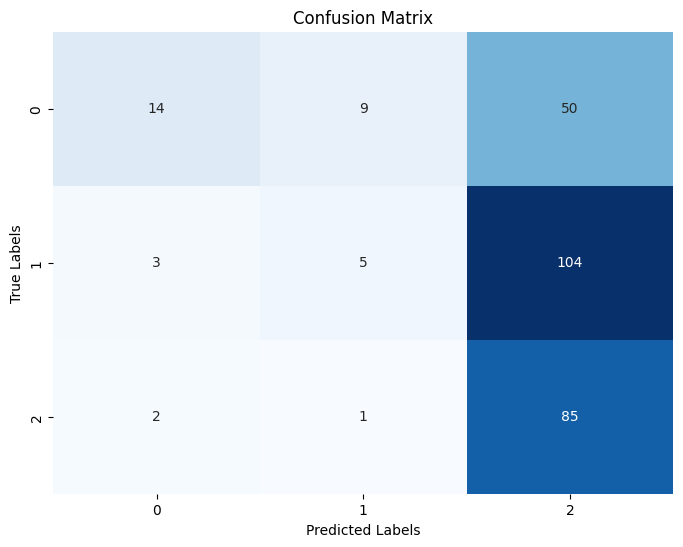

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Assuming you have the test_labels and test_predictions obtained from your model

# Create a confusion matrix
confusion = confusion_matrix(test_labels, test_predictions)

# Print the Confusion Matrix
print("Confusion Matrix:")
print(confusion)

# Display the Confusion Matrix as a Heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', cbar=False)
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.title('Confusion Matrix')
plt.show()
